Importing Libraries

In [2]:
# Data Preproessing libraries
import pandas as pd
import numpy as np

# Data Visualisation libraries
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px 

#Feature Importance libraries
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split, cross_val_score, StratifiedKFold
import xgboost as xgb

import pickle 


# Hyperparameter Tuning libraries
from hyperopt import hp, fmin, tpe, Trials, STATUS_OK

# Model Evaluation libraries
from sklearn.metrics import auc, accuracy_score, roc_auc_score, roc_curve, f1_score, confusion_matrix, classification_report, ConfusionMatrixDisplay, precision_recall_curve

# Class Sampling libraries
from sklearn.utils import resample
from imblearn.over_sampling import SMOTE

# Feature Scaling libraries
from sklearn.preprocessing import StandardScaler

# Exploratory Data Analysis (EDA) and Visualisation

##### EDA QUESTIONS: The analysis done below, will be used to answer the following questions:<br>
Question 1: How does Wait time affect no-show ?<br>

Question 2: How does Age affect no-show ?<br>

Question 3: How does Gender affect no-show ?<br>

Question 4: How does Neighbourhood affect no-show ?<br>

Question 5: How does weekday affect no-show ?<br>

Question 6: How does Appointment Count affect no-show ?<br>

Question 7: How does Medical condtions/Patient disease risk (Hypertension, Alcoholism, Handicap, Diabetes) affect no-show ?<br>

Question 8: How does sms reminders affect no-show ?


In [4]:
# Create a new dataframe from cleaned dataset
clean_appointments_df = pd.read_csv('data/cleaned_medical_appointments.csv')

In [5]:
# Check all the columns in the cleaned dataset
clean_appointments_df.columns

Index(['patientid', 'appointmentid', 'gender', 'scheduledday',
       'appointmentday', 'age', 'neighbourhood', 'scholarship', 'hypertension',
       'diabetes', 'alcoholism', 'handicap', 'sms_received', 'no-show',
       'weekday', 'waittime', 'appointmentcount'],
      dtype='object')

In [6]:
# visualize clean_appointments_df
clean_appointments_df.head()

,patientid,appointmentid,gender,scheduledday,appointmentday,age,neighbourhood,scholarship,hypertension,diabetes,alcoholism,handicap,sms_received,no-show,weekday,waittime,appointmentcount
0,2.987250e+13,5642903,F,2016-04-29,2016-04-29,62,JARDIM DA PENHA,0,1,0,0,0,0,0,Friday,0,2
1,5.589978e+14,5642503,M,2016-04-29,2016-04-29,56,JARDIM DA PENHA,0,0,0,0,0,0,0,Friday,0,2
2,4.262962e+12,5642549,F,2016-04-29,2016-04-29,62,MATA DA PRAIA,0,0,0,0,0,0,0,Friday,0,2
3,8.679512e+11,5642828,F,2016-04-29,2016-04-29,8,PONTAL DE CAMBURI,0,0,0,0,0,0,0,Friday,0,2
4,8.841186e+12,5642494,F,2016-04-29,2016-04-29,56,JARDIM DA PENHA,0,1,1,0,0,0,0,Friday,0,1


array([[<Axes: title={'center': 'patientid'}>,
        <Axes: title={'center': 'appointmentid'}>,
        <Axes: title={'center': 'age'}>],
       [<Axes: title={'center': 'scholarship'}>,
        <Axes: title={'center': 'hypertension'}>,
        <Axes: title={'center': 'diabetes'}>],
       [<Axes: title={'center': 'alcoholism'}>,
        <Axes: title={'center': 'handicap'}>,
        <Axes: title={'center': 'sms_received'}>],
       [<Axes: title={'center': 'no-show'}>,
        <Axes: title={'center': 'waittime'}>,
        <Axes: title={'center': 'appointmentcount'}>]], dtype=object)

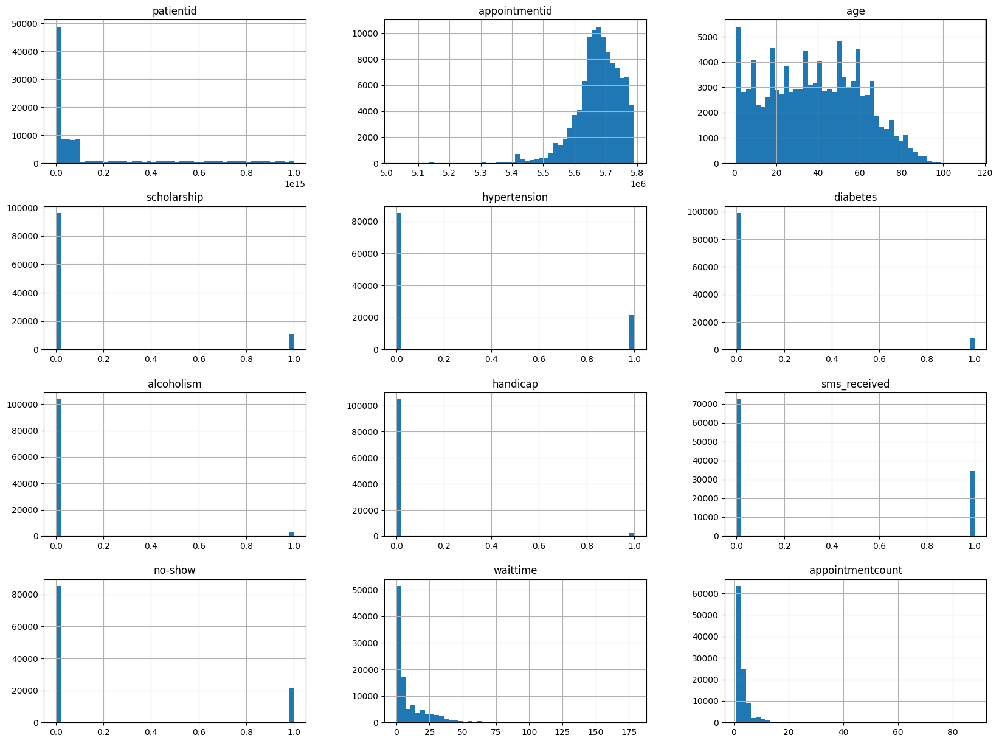

In [7]:
# plot the data distribution of the dataset across all the columns including the date columns
clean_appointments_df.hist(bins=50, figsize=(20,15))

In [8]:
# drop the rows where the waiting time is negative
clean_appointments_df.drop(clean_appointments_df[clean_appointments_df["waittime"] < 0].index, inplace=True)

The appointments scheduled after the appointment day have been removed leaving the dataset with appointments scheduled before the appointment day and on the same day as the appointment day

In [7]:
# Create a dataframe representing waiting_days by grouping the "WaitTime" column by the "No-show" column using the patient_id as the index
waittime_df = clean_appointments_df.groupby(by=["waittime", "no-show"]).count()['patientid'].unstack()

In [8]:
# Fill the missing values in the waiting_data dataframe with 0
waittime_df.fillna(value=0, inplace=True)
waittime_df.reset_index(drop=False, inplace=True)
waittime_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 129 entries, 0 to 128
Data columns (total 3 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   waittime  129 non-null    int64  
 1   0         129 non-null    float64
 2   1         129 non-null    float64
dtypes: float64(2), int64(1)
memory usage: 3.1 KB


In [9]:
# view the waittime_df dataframe
waittime_df

no-show,waittime,0,1
0,0,35413.0,1741.0
1,1,3953.0,1075.0
2,2,5052.0,1584.0
3,3,2016.0,623.0
4,4,4003.0,1209.0
...,...,...,...
124,155,4.0,6.0
125,162,9.0,2.0
126,169,7.0,1.0
127,176,10.0,6.0


### Create waiting categories to visualise patient no-show distribution across wait time intervals


In [10]:
# create waiting categories label for the waiting time using pandas series
categories = pd.Series(["Same day:0", "Few Days:1-3", "Week: 4-7", "2 Weeks:8-15", "Month:16-30", "3 Months:31-90", "6 Months:91-180", "> 6months 181-365"])

In [11]:
## Apply the waiting categories to clean_appointments_df dataframe and the waittime_df dataframe
## The waiting time is divided into 8 categories based on the number of days the patient has to wait for the appointment
## The categories are used to group the waiting time for the patients into different waiting time periods(0-1 days, 2-7 days, 8-30 days, 31-90 days, 91-180 days, 181-365 days, 365+ days)
waittime_df["waittime"] = pd.cut(waittime_df["waittime"], bins=[0, 1, 3, 7, 15, 30, 90, 180, 365], labels=categories)
clean_appointments_df["wait_categories"] = pd.cut(clean_appointments_df["waittime"], bins=[0, 1, 3, 7, 15, 30, 90, 180, 365], labels=categories)

CALCULATE NO-SHOW RATE TO RELATE SHOW-UP TO NO-SHOW PATIENTS

In [12]:
# Group the 'waittime_df' dataframe by waiting categories to show the sum of all no-show instances for each waiting category
waittime_df = waittime_df.groupby("waittime").sum()
## create new column in the "waiting_data" to calculate the relation between the no-show and show appointments
waittime_df["no_show_rate"] = (waittime_df[1] / waittime_df[0]) * 100

C:\Users\ktamu\AppData\Local\Temp\ipykernel_20868\1941083898.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  waittime_df = waittime_df.groupby("waittime").sum()


In [13]:
waittime_df

no-show,0,1,no_show_rate
waittime,,,
Same day:0,3953.0,1075.0,27.194536
Few Days:1-3,7068.0,2207.0,31.225241
Week: 4-7,12842.0,4301.0,33.491668
2 Weeks:8-15,9046.0,4039.0,44.649569
Month:16-30,10304.0,4997.0,48.495730
3 Months:31-90,6524.0,3260.0,49.969344
6 Months:91-180,157.0,55.0,35.031847
> 6months 181-365,0.0,0.0,NaN


### CALCULATE NO-SHOW RATE TO RELATE SHOW-UP TO NO-SHOW PATIENTS

In [14]:
waittime_df_eda = waittime_df.copy()# create a copy of the waittime_df dataframe for exploratory data analysis
waittime_df_eda.reset_index(drop=False, inplace=True) # reset the index of the waittime_df_eda dataframe for further analysis and visualization
waittime_df_eda.drop(7, inplace=True) # drop the last row in the waittime_df_eda dataframe as it is contains empty values.

In [15]:
# Add a new column to the waittime_df_eda dataframe to show the percentage of no-show appointments for each waiting category
waittime_df_eda["no_show_percent"] = waittime_df_eda["no_show_rate"].apply(lambda x: round(x, 2))

In [16]:
# multiplpy the no_show_rate by a fixed factor to get a better visualization of the data
waittime_df_eda["no_show_rate"] = waittime_df_eda["no_show_rate"] * 500

In [17]:
waittime_df_eda

no-show,waittime,0,1,no_show_rate,no_show_percent
0,Same day:0,3953.0,1075.0,13597.267898,27.19
1,Few Days:1-3,7068.0,2207.0,15612.620260,31.23
2,Week: 4-7,12842.0,4301.0,16745.833982,33.49
3,2 Weeks:8-15,9046.0,4039.0,22324.784435,44.65
4,Month:16-30,10304.0,4997.0,24247.864907,48.50
5,3 Months:31-90,6524.0,3260.0,24984.671980,49.97
6,6 Months:91-180,157.0,55.0,17515.923567,35.03


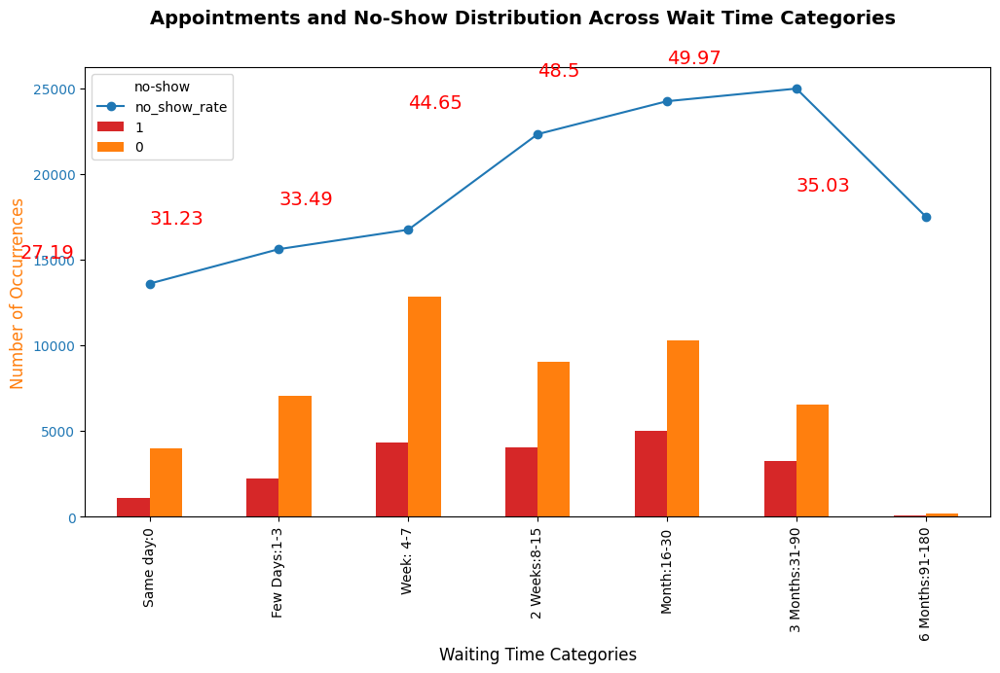

In [206]:
## Plot a graph to show the relationship between the waiting time and the no-show rate across all the waiting categories
## Setting the graph parameters:

# Define graph parameters
fig, ax = plt.subplots(figsize=[12, 6])
fig.subplots_adjust(top=0.88)
plt.suptitle('Appointments and No-Show Distribution Across Wait Time Categories', fontsize=14, fontweight='bold')

# Define colors for the plot
colors = ['tab:blue', 'tab:green', 'tab:red', 'tab:orange']

# Set y-axis label and color
ax.set_ylabel('Number of Occurrences', color=colors[3], fontsize=12)
ax.tick_params(axis='y', labelcolor=colors[0])

# Plot line chart for no-show rate
waittime_df_eda.plot(x='waittime', y='no_show_rate', linestyle='-', marker='o', ax=ax, color=colors[0])

# Add labels for line chart markers
x_ticks = ax.get_xticks()
for x_tick, no_show_rate, no_show_percent in zip(x_ticks, waittime_df_eda['no_show_rate'], waittime_df_eda['no_show_percent']):
    plt.text(x_tick, no_show_rate + 1500, no_show_percent, color='red', fontsize=14)

# Plot bar chart for no-show and show counts
waittime_df_eda.plot(x='waittime', y=[1, 0], kind='bar', ax=ax, color=colors[2:])

# Set x-axis label
ax.set_xlabel('Waiting Time Categories', fontsize=12)

plt.show()


### VISUALIZE TARGET VARIABLE (SHOW/NO-SHOW) DISTRIBUTION

In [24]:
# Show and No-show count of patients
print(clean_appointments_df["no-show"].value_counts())

## Find the percentage of show and no-show patients in the dataset
show = clean_appointments_df["no-show"].value_counts()[0]
no_show = clean_appointments_df["no-show"].value_counts()[1]
total = show + no_show
show_percent = (show / total) * 100
no_show_percent = (no_show / total) * 100

print("The percentage of patients who showed up is {:.2f}%".format(show_percent))
print("The percentage of patients who did not show up is {:.2f}%".format(no_show_percent))

no-show
0    85307
1    21675
Name: count, dtype: int64
The percentage of patients who showed up is 79.74%
The percentage of patients who did not show up is 20.26%


In [ ]:
## Plot a bar graph of show and no-show patients in the dataset
plt.figure(figsize=(10, 6))
sns.countplot(x=clean_appointments_df["no-show"], data=clean_appointments_df, legend=True)
plt.title("Number of Show and No-show Patients")
plt.xlabel("Show/No-show")
plt.ylabel("Number of Patients")
plt.xticks([0, 1], ["Show", "No-show"])
plt.show()

In [52]:
# Count the occurrences of show and no-show
show_no_show_counts = clean_appointments_df['no-show'].value_counts().reset_index()
show_no_show_counts.columns = ['Show/No-show', 'Number of Patients']

# Create a bar plot using Plotly
fig = px.bar(show_no_show_counts, x='Show/No-show', y='Number of Patients', color='Show/No-show',
             title="Number of Show and No-show Patients",
             labels={'Show/No-show': 'Show/No-show', 'Number of Patients': 'Number of Patients'})

fig.update_layout(xaxis=dict(tickmode='array', tickvals=[0, 1], ticktext=["Show", "No-show"]), width=700, height=700)
fig.show()


#### NO SHOWS ACROSS GENDER

Visualise the number of male and female patients in the dataset to better understand the distribution of the target variable (no-shows)

In [114]:
# 3. Calculate the number of male appointments
num_male_appointments = clean_appointments_df[clean_appointments_df['gender'] == 'M'].shape[0]
print("Number of male appointments:", num_male_appointments)

# 4. Calculate the number of female appointments
num_female_appointments = clean_appointments_df[clean_appointments_df['gender'] == 'F'].shape[0]
print("Number of female appointments:", num_female_appointments)

# find the number of appointments missed by males
num_missed_male = clean_appointments_df[(clean_appointments_df['gender'] == 'M') & (clean_appointments_df['no-show'] == 0)].shape[0]

# find the number of appointments missed by females
num_missed_fem = clean_appointments_df[(clean_appointments_df['gender'] == 'F') & (clean_appointments_df['no-show'] == 0)].shape[0]


print("Female Appointments Attended:", num_attended_fem := num_female_appointments - num_missed_fem)
print("male Appointments Attended:", num_attended_male := num_male_appointments - num_missed_male)

Number of male appointments: 36867
Number of female appointments: 70115
Female Appointments Attended: 14272
male Appointments Attended: 7403


In [ ]:
# Calculate the count of of women and men in the dataset
# visualize men and women in the dataset
gender_distribution = clean_appointments_df['gender'].value_counts()

# Plotting the distribution using a bar plot
plt.figure(figsize=(8, 6))
gender_distribution.plot(kind='bar', color=['pink', 'blue'])
plt.title('Distribution of Male and Female Patients')
plt.xlabel('Gender')
plt.ylabel('Number of Patients')
plt.xticks(rotation=0)  # Rotate x-axis labels if needed
plt.show()


In [53]:
import plotly.graph_objects as go

# Calculate the count of women and men in the dataset
gender_distribution = clean_appointments_df['gender'].value_counts()

# Creating the Plotly bar plot
fig = go.Figure(data=[
    go.Bar(
        x=gender_distribution.index,
        y=gender_distribution.values,
        marker_color=['pink', 'blue']
    )
])

# Updating the layout of the plot
fig.update_layout(
    title='Distribution of Male and Female Patients',
    xaxis_title='Gender',
    yaxis_title='Number of Patients',
    xaxis=dict(tickmode='array', tickvals=[0, 1], ticktext=['Female', 'Male']),
    width=700,
    height=700
)

# Showing the plot
fig.show()


In [ ]:
# Sns plot no-show
ax = sns.countplot(x=clean_appointments_df["gender"], hue=clean_appointments_df["no-show"], data=clean_appointments_df)
ax.set_title("Number of No-shows for Male and Female Patients")
ax.set_xticklabels(["Female", "Male"])
plt.show()

In [55]:
fig = px.histogram(
    clean_appointments_df,
    x="gender",
    color="no-show",
    barmode="group",
    title="Number of No-shows for Male and Female Patients",
    category_orders={"gender": ["F", "M"]},  # To ensure the order of Female and Male
    labels={"gender": "Gender", "count": "Number of Patients", "no-show": "No-show Status"}
)

# Updating x-axis tick labels
fig.update_xaxes(ticktext=["Female", "Male"], tickvals=["F", "M"])

fig.update_layout(width=700, height=700)

# Show the plot
fig.show()

In [ ]:
# percentage no-show ratio across gender
gender_ratio_df = clean_appointments_df[clean_appointments_df["no-show"] == 1].groupby("gender").size() / clean_appointments_df.groupby("gender").size()

# Plot the percentage no-show ratio across gender
ax = sns.barplot(x=gender_ratio_df.index, y=gender_ratio_df)
ax.set_title("Percentage No-show rate for Patients based on gender")
x_ticks = ["Female", "Male"]
ax.set_xticklabels(x_ticks)

plt.show()

In [56]:
# Calculate the percentage no-show ratio across gender
gender_ratio_df = clean_appointments_df[clean_appointments_df["no-show"] == 1].groupby("gender").size() / clean_appointments_df.groupby("gender").size()

# Convert the Series to a DataFrame for Plotly
gender_ratio_df = gender_ratio_df.reset_index()
gender_ratio_df.columns = ["gender", "no_show_ratio"]

# Plot the percentage no-show ratio across gender using Plotly
fig = px.bar(
    gender_ratio_df,
    x="gender",
    y="no_show_ratio",
    title="Percentage No-show Rate for Patients Based on Gender",
    labels={"gender": "Gender", "no_show_ratio": "No-show Rate"},
    category_orders={"gender": ["F", "M"]}  # Ensure the order of Female and Male
)

fig.update_layout(width=700, height=700)

# Show the plot
fig.show()

The percentage no-shows reveal that women are more likely to miss their appointments although the difference is not too significant as the percentage of no-shows for both male and female patients is close and also women have a higher number of appointments and make up a larger percentage of the dataset making it skewed towards them.

### NO-SHOWS ACROSS AGE GROUPS

In [ ]:
# Age disribution no-shows
plt.figure(figsize=(16, 2))
plt.xticks(rotation=90)
ax = sns.boxplot(x=clean_appointments_df["age"])

In [57]:
# Create a box plot of the age distribution of no-shows
fig = px.box(
    clean_appointments_df, 
    x="age",
    title="Age Distribution of No-shows"
)

# Update layout to adjust figure size and x-axis label rotation
fig.update_layout(
    width=1000, 
    height=400,
    xaxis_title="Age",
    yaxis_title="",
    xaxis=dict(tickangle=90)
)

# Show the plot
fig.show()

In [ ]:
# Create a count plot of show/no-show by age using Plotly Express
fig = px.histogram(clean_appointments_df, x="age", color="no-show", barmode="group", title="Show/No-Show by Age")

# Update layout to adjust figure size and x-axis label rotation
fig.update_layout(
    width=1200,
    height=400,
    xaxis_title="Age",
    yaxis_title="Count",
    xaxis=dict(tickangle=90),
    legend_title="No-show"
)

# Show the plot
fig.show()

In [ ]:
# Define figure size and rotate x-axis labels
plt.figure(figsize=(16, 4))
plt.xticks(rotation=90)

# Create age groups divided into 5 categories: 0-18, 19-37, 38-55, 56-74, and 75-115
age_group_data = clean_appointments_df.copy()
age_group_data["AgeGroup"] = pd.cut(age_group_data["age"], bins=[0, 18, 37, 55, 74, 115], labels=["0-18", "19-37", "38-55", "56-74", "75-115"])

# Plot count of age groups with no-show status
ax = sns.countplot(x="AgeGroup", hue="no-show", data=age_group_data)

In [61]:
# Create age groups divided into 5 categories: 0-18, 19-37, 38-55, 56-74, and 75-115
clean_appointments_df["AgeGroup"] = pd.cut(clean_appointments_df["age"], bins=[0, 18, 37, 55, 74, 115], labels=["0-18", "19-37", "38-55", "56-74", "75-115"])

# Create a count plot of age groups with no-show status using Plotly Express
fig = px.histogram(clean_appointments_df, x="AgeGroup", color="no-show", barmode="group", title="Show/No-Show by Age Group")

# Update layout to adjust figure size and x-axis label rotation
fig.update_layout(
    width=1200,
    height=400,
    xaxis_title="Age Group",
    yaxis_title="Count",
    xaxis=dict(tickangle=90),
    legend_title="No-show"
)

# Show the plot
fig.show()

This shows the distribution of no-shows across different age groups. The age groups are divided into 5 categories: 0-18, 19-37, 38-55, 56-74, and 75-115.
The distribution shows that the age group 19-37 has the highest number of no-shows, followed by the age group 0-18.
This is an interesting observation because one would expect the elderly to have the highest number of no-shows due to health issues but rather the younger age groups approaching adulthood have the highest number of no-shows.

### NO-SHOW DISTRIBUTION ACROSS NEIGHBOURHOODS

In [ ]:
# appointment distribution across Neighbourhoods
plt.figure(figsize=(16, 6))
plt.xticks(rotation=90)
ax = sns.countplot(x=np.sort(clean_appointments_df["neighbourhood"]), hue=clean_appointments_df["no-show"])
ax = plt.gca()
ax.set_title("No-shows/Shows of appointments for each Neighbourhood")
plt.show()

In [68]:
# Create a count plot of appointment distribution across Neighbourhoods using Plotly Express
fig = px.histogram(clean_appointments_df, x="neighbourhood", color="no-show", barmode="group", title="No-shows/Shows of Appointments for Each Neighbourhood")

# Update layout to adjust figure size and x-axis label rotation
fig.update_layout(
    width=1200,
    height=600,
    xaxis_title="Neighbourhood",
    yaxis_title="Count",
    xaxis=dict(tickangle=90),
    legend_title="No-show"
)

# Show the plot
fig.show()

In [ ]:
# ratio of no-shows across all neighbourhoods
neighbourhood_ratio = clean_appointments_df.groupby("neighbourhood")["no-show"].sum() / clean_appointments_df.groupby("neighbourhood")["no-show"].count()

plt.figure(figsize=(16, 6))
plt.xticks(rotation=90)
ax = sns.barplot(x=neighbourhood_ratio.index, y=neighbourhood_ratio)
ax.set_title("Percentage No-show rate by Neighbourhood")

In [71]:
neighbourhood_ratio = clean_appointments_df.groupby("neighbourhood")["no-show"].sum() / clean_appointments_df.groupby("neighbourhood")["no-show"].count()
neighbourhood_ratio = neighbourhood_ratio * 100
neighbourhood_ratio = neighbourhood_ratio.sort_values(ascending=False)

# Create a bar plot of the ratio of no-shows across all neighbourhoods using Plotly Express
fig = px.bar(x=neighbourhood_ratio.index, y=neighbourhood_ratio, labels={"x": "Neighbourhood", "y": "Percentage No-show rate"}, 
             title="Percentage No-show rate by Neighbourhood")

# Update layout to adjust figure size and x-axis label rotation
fig.update_layout(
    xaxis=dict(tickangle=90),
    width=1200,
    height=600
)

# Show the plot
fig.show()

The no-show rates are distributed across different neighbourhoods within the range of 20% to 30%. The neighbourhoods with the highest number of no-shows are JARDIM CAMBURI, MARIA ORTIZ, and ITARARÉ while the neighbourhoods with the lowest number of no-shows are PARQUE INDUSTRIAL, ILHA DO BOI, and AEROPORTO.

### NO-SHOWS ACROSS PATIENTS WITH SCHOLARSHIP

In [ ]:
# count of shows and no-shows across the different patients with scholarships

ax = sns.countplot(x=clean_appointments_df["scholarship"], hue=clean_appointments_df["no-show"], data=clean_appointments_df)
ax.set_title("Number of No-shows for Patients with Scholarships")
x_ticks = ["No Scholarship", "Scholarship"]
ax.set_xticklabels(x_ticks)
plt.show()

In [77]:
fig = px.histogram(
    clean_appointments_df,
    x="scholarship",
    color="no-show",
    barmode="group",
    title="Number of No-shows for Patients with Scholarships",
    labels={"scholarship": "Scholarship", "count": "Number of Patients", "no-show": "No-show Status"}
)

# Update x-axis tick labels
fig.update_xaxes(tickvals=[0, 1], ticktext=["No Scholarship", "Scholarship"])

fig.update_layout(width=700, height=700)

# Show the plot
fig.show()

### NO-SHOWS ACROSS DAYS OF THE WEEK

In [ ]:
# PLOT THE PATIENT NO-SHOW ACROSS THE DAYS OF THE WEEK

week_days = ["Sunday", "Monday", "Tuesday", "Wednesday", "Thursday", "Friday", "Saturday"]

plt.figure(figsize=(10, 6))
ax = sns.countplot(x=clean_appointments_df["weekday"], order=week_days)
ax.set_title("Number of No-shows for each Day of the Week")
plt.show()

In [92]:
# PLOT THE PATIENT NO-SHOW ACROSS THE DAYS OF THE WEEK
# week_days = ["Sunday", "Monday", "Tuesday", "Wednesday", "Thursday", "Friday", "Saturday"]

# # Create a bar plot of the count of no-shows for each day of the week using Plotly Express
# fig = px.bar(clean_appointments_df, x="weekday", title="Number of No-shows for each Day of the Week")
# fig.update_layout(xaxis=dict(categoryorder='array', categoryarray=week_days))
# fig.show()

data = clean_appointments_df.copy()

weekday_counts = data.groupby(['weekday', 'no-show']).size().unstack(fill_value=0)
fig1 = go.Figure(data=[
    # go.Bar(name='Show', x=weekday_counts.index, y=weekday_counts[0]),
    go.Bar(name='No-Show', x=weekday_counts.index, y=weekday_counts[1])
])
fig1.update_layout(barmode='stack', title='Effect of Weekday on No-Show', xaxis_title='Weekday', yaxis_title='Count', width=800, height=500)
fig1.show()

The plot for no-shows across weekdays shows that the no-show rates are highest on Wednesdays and lowest on Saturdays and Sundays. This is suprising because one would think that no-show rates are higher on Mondays and Fridays due to proximity to the weekend but rather, the weekdays have the highest no-show rates, especially Tuesdays and Wednesdays while the weekends have the lowest no-show rates. This shows that the patients are more likely to show up for appointments on weekends than on weekdays.

### NO-SHOWS ACROSS PATIENTS WHO RECEIVED SMS REMINDERS

In [ ]:
# plot the number of no-shows for patients who received SMS vs those who did not receive SMS
ax = sns.countplot(x=clean_appointments_df["sms_received"], hue=clean_appointments_df["no-show"], data=clean_appointments_df)
ax.set_title("Number of No-shows for Patients who received SMS")
x_ticks = ["No SMS", "SMS"]
ax.set_xticklabels(x_ticks)
plt.show()

In [80]:
# plot the number of no-shows for patients who received SMS vs those who did not receive SMS
fig = px.histogram(
    clean_appointments_df,
    x="sms_received",
    color="no-show",
    barmode="group",
    title="Number of No-shows for Patients who received SMS",
    labels={"sms_received": "SMS_Received", "count": "Number of Patients", "no-show": "No-show Status"}
)

# Update x-axis tick labels
fig.update_xaxes(tickvals=[0, 1], ticktext=["No SMS", "SMS"])

fig.update_layout(width=700, height=700)

# Show the plot
fig.show()

### NO-SHOW ACROSS PATIENTS WITH DISEASES/MEDICAL CONDITIONS

In [131]:
# create a column representing the risk of patients who have two or more medical conditions in the dataset
# clean_appointments_df['at_risk'] = clean_appointments_df[['hypertension', 'diabetes', 'alcoholism']].sum(axis=1).apply(lambda x: 1 if x >= 1 else 0)

In [82]:
clean_appointments_df['at_risk'] = np.where((clean_appointments_df['hypertension'] + clean_appointments_df['diabetes'] + clean_appointments_df['alcoholism']) >= 2, 1, 0)

In [133]:
# view the at_risk column in the clean_appointments_df dataframe
clean_appointments_df['at_risk'].describe()

count    106982.000000
mean          0.071348
std           0.257407
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max           1.000000
Name: at_risk, dtype: float64

In [ ]:
# plot the patients at risk(with two or more medical conditions) and the no-shows
ax = sns.countplot(x=clean_appointments_df["at_risk"], hue=clean_appointments_df["no-show"], data=clean_appointments_df)
ax.set_title("Number of No-shows for Patients at Risk")
x_ticks = ["Risk", "No Risk"]
ax.set_xticklabels(x_ticks)
plt.show()


In [83]:
# plot the patients at risk(with two or more medical conditions) and the no-shows
fig = px.histogram(
    clean_appointments_df,
    x="at_risk",
    color="no-show",
    barmode="group",
    title="Number of No-shows for Patients at Risk",
    labels={"at_risk": "At_Risk", "count": "Number of Patients", "no-show": "No-show Status"}
)

# Update x-axis tick labels
fig.update_xaxes(tickvals=[0, 1], ticktext=["Risk", "No Risk"])

fig.update_layout(width=700, height=700)

# Show the plot
fig.show()

Some patients with more than one health condition are at risk and this could possibly be a reason for their no-shows. The plot shows that patients with one or more health conditions have a lower number of no-shows while patients with 1 or no health conditions have the higher number of no-shows so the healthier patients miss more appointments.

### NO-SHOW ACROSS PATIENTS WITH HANDICAP


In [ ]:
# Plot the number of no-shows for ladies with handicap and those without handicap
ax = sns.countplot(x=clean_appointments_df["handicap"], hue=clean_appointments_df["no-show"], data=clean_appointments_df)
ax.set_title("Number of no-shows for Patients with Handicap")
x_ticks = ["No Handicap", "Handicap"]
ax.set_xticklabels(x_ticks)
plt.show()

In [84]:
# plot the patients at risk(with two or more medical conditions) and the no-shows
fig = px.histogram(
    clean_appointments_df,
    x="handicap",
    color="no-show",
    barmode="group",
    title="Number of no-shows for Patients with Handicap",
    labels={"handicap": "Handicap", "count": "Number of Patients", "no-show": "No-show Status"}
)

# Update x-axis tick labels
fig.update_xaxes(tickvals=[0, 1], ticktext=["No Handicap", "Handicap"])

fig.update_layout(width=700, height=700)

# Show the plot
fig.show()

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Load the data
data = pd.read_csv('data/cleaned_medical_appointments.csv')

# Convert 'no-show' to a binary variable if it's not already
data['no-show'] = data['no-show'].apply(lambda x: 1 if x == 'Yes' else 0)

# Create 'at_risk' feature
data['at_risk'] = np.where((data['hypertension'] + data['diabetes'] + data['alcoholism']) >= 2, 1, 0)

# Set up the matplotlib figure
fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(15, 10))
fig.tight_layout(pad=5.0)

# Q1: Wait time vs no-show
sns.boxplot(x='no-show', y='waittime', data=data, ax=ax1)
ax1.set_title('Effect of Wait Time on No-Show')

# Q2: Age vs no-show
sns.boxplot(x='no-show', y='age', data=data, ax=ax2)
ax2.set_title('Effect of Age on No-Show')

# Q3: Gender vs no-show
sns.countplot(x='gender', hue='no-show', data=data, ax=ax3)
ax3.set_title('Effect of Gender on No-Show')

# Q4: Neighbourhood vs no-show
# Using a smaller plot for neighborhood due to space constraints
top_neighborhoods = data['neighbourhood'].value_counts().index[:10]  # Top 10 neighborhoods
filtered_data = data[data['neighbourhood'].isin(top_neighborhoods)]
sns.countplot(y='neighbourhood', hue='no-show', data=filtered_data, ax=ax4)
ax4.set_title('Effect of Neighbourhood on No-Show')

# Create a new figure for additional plots
fig2, ((ax5, ax6), (ax7, ax8)) = plt.subplots(2, 2, figsize=(15, 10))
fig2.tight_layout(pad=5.0)

# Q5: Weekday vs no-show
sns.countplot(x='weekday', hue='no-show', data=data, ax=ax5, order=['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday'])
ax5.set_title('Effect of Weekday on No-Show')

# Q6: Appointment Count vs no-show
fig3, ax6 = plt.subplots(figsize=(7, 5))
sns.countplot(x='appointmentcount', hue='no-show', data=data, ax=ax6)
ax6.set_title('Effect of Appointment Count on No-Show')

# Q7: At Risk vs no-show
# fig3, ax7 = plt.subplots(figsize=(7, 5))
sns.countplot(x='at_risk', hue='no-show', data=data, ax=ax7)
ax7.set_title('Effect of Being At Risk on No-Show')

# Q7: SMS Received vs no-show
# fig4, ax8 = plt.subplots(figsize=(7, 5))
sns.countplot(x='sms_received', hue='no-show', data=data, ax=ax8)
ax8.set_title('Effect of SMS Received on No-Show')

plt.show()


Text(0.5, 1.0, 'Effect of Appointment Count on No-Show')

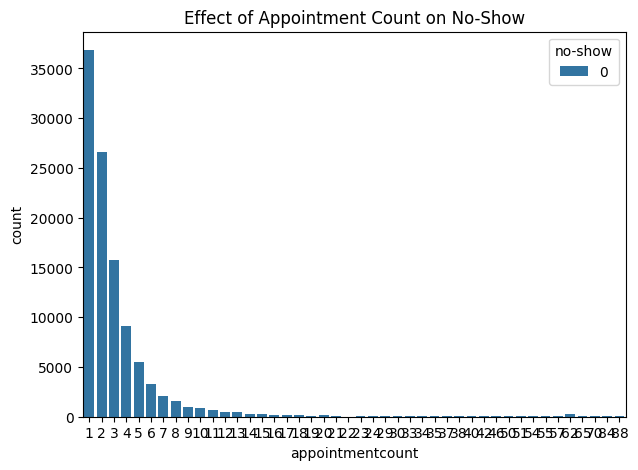

In [11]:

# Q6: Appointment Count vs no-show
fig3, ax6 = plt.subplots(figsize=(7, 5))
sns.countplot(x='appointmentcount', hue='no-show', data=data, ax=ax6)
ax6.set_title('Effect of Appointment Count on No-Show')



## FEATURE ENGINEERING
This process involves selecting important features from the existing dataset that can improve the model's performance. This may also include creating new features from the existing features, feature extraction, dimensionality reduction or creating interaction variables. The goal is to improve the model's performance by selecting the most important features that can help the model to better predict the target variable.

##### VARIABLE INDEPENDENCE

To select the feature variables that will be used to build the model and answer the research question 2 (RQ 2: What factors strongly influence no-show), the correlation between the feature variables and the target variable will be calculated. The feature variables showing stronger correlation with the target variable will be selected to build the model while the features with lower correlation will be dropped as they have no significance in the analysis.

These methods for feature selection will be used:
1. Statistical tests: Chi-Square test (Suitable for checking correlation between categorical variables)
2. Feature Correlation: Pearson Correlation Coefficient and Phi Coefficient (Suitable for checking correlation between continuous variables and binary variables)
3. Feature Importance: Random Forest Classifier, Extra Trees Classifier, and XGBoost Classifier, Logistic Regession Classifier

### Chi-Square Test:
<br> This test is used to determine the association between categorical variables or binary variables to test the independence of two variables (feature independence). <br> The null hypothesis is that the two variables are independent while the alternative hypothesis is that the two variables are dependent.<br> This test is used to determine the relationship between the target variable and the feature variables and it will help to select the feature variables that will be used to build the model.

<br>Objective: To understand how the categorical feature variables have an impact on the likelihood of the patient missing the appointment

* Ho - Null Hypothesis: The two variables are independent
* H1 - Alternative Hypothesis: The two variables are dependent

<br>Significance level: A significance level (alpha) of 0.05 will be used for this test.

<br>Expected Outcome: If the p-value is less than 0.05, the null hypothesis will be rejected and the two variables will be considered dependent. If the
p-value is greater than 0.05, the null hypothesis will be accepted and the two variables will be considered independent.

$$ chi_squared = np.sum((observed - expected)**2 / expected)

In [93]:
# create a function that takes takes a categorical column and the target column as input and returns the chi2 value and p-value
from scipy.stats import chi2_contingency

# create a function to perform the chi2 test
def chi2_test(categorical_column, target_column, significance_level):
    contingency_table = pd.crosstab(categorical_column, target_column)
    chi2, p, dof, expected = chi2_contingency(contingency_table)

    if p < significance_level:
        print(f"Accept the alternate hypothesis: There is a significant relationship between {categorical_column.name} and {target_column.name}")
    else:
        print(f"Accept the null hypothesis: There is no significant relationship between {categorical_column.name} and {target_column.name}")
    return chi2, p, dof


I will loop through all the relevant feature columns and calculate the chi-squared value for each binary feature column and the target variable. The feature columns with the p-values less than 0.05 show a significant association to the target variable.

In [94]:
# loop through all the binary columns in the dataset an calculate the chi2 value and p-value

feature_columns = ['patientid', 'appointmentid', 'scheduledday', 'appointmentday', 'no-show', 'Wait_Categories', 'waittime', 'weekday','appointmentcount', 'neighbourhood']
for column in clean_appointments_df.columns:
    if column not in feature_columns:
        chi2, p, dof = chi2_test(clean_appointments_df[column], clean_appointments_df['no-show'], 0.05)
        print(f"Chi2 value for {column} is {chi2} \n p-value is {p} \n Degrees of freedom is {dof} \n")

Accept the null hypothesis: There is no significant relationship between gender and no-show
Chi2 value for gender is 1.1128026493714103 
 p-value is 0.29147352523998726 
 Degrees of freedom is 1 

Accept the alternate hypothesis: There is a significant relationship between age and no-show
Chi2 value for age is 989.9119410417138 
 p-value is 6.879361739254303e-146 
 Degrees of freedom is 101 

Accept the alternate hypothesis: There is a significant relationship between scholarship and no-show
Chi2 value for scholarship is 92.25214240983308 
 p-value is 7.63074922318832e-22 
 Degrees of freedom is 1 

Accept the alternate hypothesis: There is a significant relationship between hypertension and no-show
Chi2 value for hypertension is 148.1083500646189 
 p-value is 4.49206836782407e-34 
 Degrees of freedom is 1 

Accept the alternate hypothesis: There is a significant relationship between diabetes and no-show
Chi2 value for diabetes is 26.90664697284986 
 p-value is 2.1352327101635502e-07 


### FEATURE CORRELATION ANALYSIS:
In this section, I analyze the correlations between features to identify significant multicollinearity which can impact the performance of some predicitve models. This would be done using Pearson correlation coefficient to measure the strength and direction of the linear relationship between two continuous variables and would be visualised as a heatmap to better understand the relationships between the features. The correlation values sgnificant are within the range (corr > 0.08 or < -0.05) as indications of multicollinearity.   

Pearson Correlation: <br> This test is used to determine the association between numerical and categorical/binary to test the independence of two variables (feature independence). <br> The null hypothesis is that the two variables are independent while the alternative hypothesis is that the two variables are dependent.<br> This test is used to determine the relationship between the target variable and the feature variables and it will help to select the feature variables that will be used to build the model.




In [95]:
# create a new dataframe to store the correlation values between the numerical columns, categorical columns and the target variable
corr_df = clean_appointments_df.drop(columns=['patientid', 'appointmentid', 'scheduledday', 'appointmentday', 'wait_categories'])
corr_df.head()

,gender,age,neighbourhood,scholarship,hypertension,diabetes,alcoholism,handicap,sms_received,no-show,weekday,waittime,appointmentcount,AgeGroup,at_risk
0,F,62,JARDIM DA PENHA,0,1,0,0,0,0,0,Friday,0,2,56-74,0
1,M,56,JARDIM DA PENHA,0,0,0,0,0,0,0,Friday,0,2,56-74,0
2,F,62,MATA DA PRAIA,0,0,0,0,0,0,0,Friday,0,2,56-74,0
3,F,8,PONTAL DE CAMBURI,0,0,0,0,0,0,0,Friday,0,2,0-18,0
4,F,56,JARDIM DA PENHA,0,1,1,0,0,0,0,Friday,0,1,56-74,1


In [96]:
# encode all the categorical columns in the dataset to make them numerical for correlation analysis
# Create a label encoder object
le = LabelEncoder()
corr_df['gender'] = le.fit_transform(clean_appointments_df['gender'])
corr_df['neighbourhood'] = le.fit_transform(clean_appointments_df['neighbourhood'])
corr_df['weekday'] = le.fit_transform(clean_appointments_df['weekday'])

# Split the data into training and testing data
# This is done to prevent data leakage and to ensure that the model generalizes well on unseen data preventing overfitting
train_data, test_data = train_test_split(corr_df, test_size=0.2, random_state=42, stratify=corr_df['no-show'])

In [97]:
# Calculate Pearson correlation for continuous variables
pearson_corr_numerical = train_data[['age', 'waittime', 'appointmentcount', 'no-show']].corr(method='pearson')

In [98]:
# Calculate Pearson correlation for binary variables by using Pearson correlation method as well
binary_variables = ['scholarship', 'hypertension', 'diabetes', 'alcoholism', 'handicap', 'sms_received', 'no-show']
phi_corr_categorical = train_data[binary_variables].corr(method='pearson')

In [99]:
pearson_corr_numerical, phi_corr_categorical

(                       age  waittime  appointmentcount   no-show
 age               1.000000  0.037603          0.052420 -0.067785
 waittime          0.037603  1.000000         -0.101202  0.185557
 appointmentcount  0.052420 -0.101202          1.000000 -0.032235
 no-show          -0.067785  0.185557         -0.032235  1.000000,
               scholarship  hypertension  diabetes  alcoholism  handicap  \
 scholarship      1.000000     -0.025102 -0.026692    0.031037 -0.007875   
 hypertension    -0.025102      1.000000  0.431951    0.081808  0.080386   
 diabetes        -0.026692      0.431951  1.000000    0.015066  0.055942   
 alcoholism       0.031037      0.081808  0.015066    1.000000  0.002249   
 handicap        -0.007875      0.080386  0.055942    0.002249  1.000000   
 sms_received     0.001392     -0.009224 -0.014506   -0.025051 -0.029963   
 no-show          0.028357     -0.038975 -0.017700   -0.003304 -0.009333   
 
               sms_received   no-show  
 scholarship       

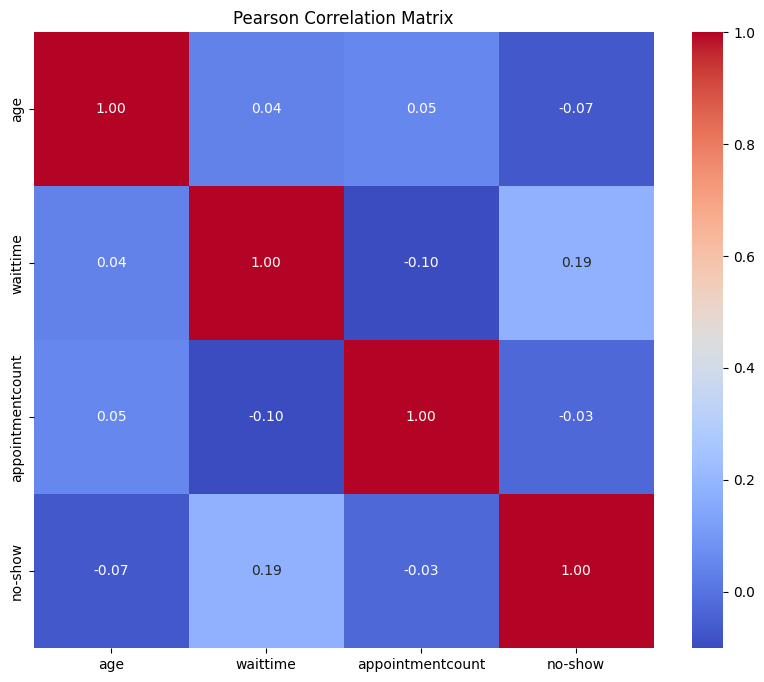

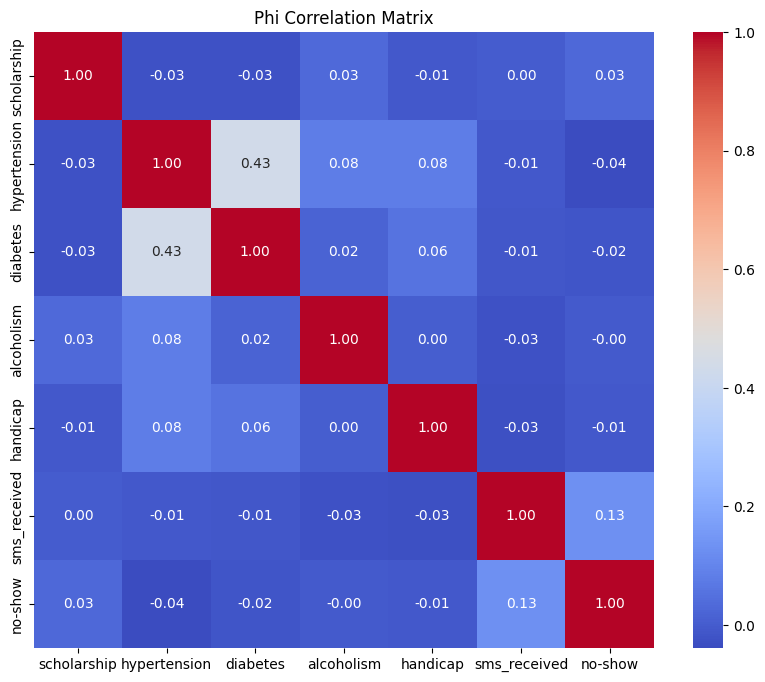

In [213]:
# Visualization of Pearson correlation matrix
plt.figure(figsize=(10, 8))
sns.heatmap(pearson_corr_numerical, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Pearson Correlation Matrix')
plt.show()

# Visualization of Phi correlation matrix
plt.figure(figsize=(10, 8))
sns.heatmap(phi_corr_categorical, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Phi Correlation Matrix')
plt.show()

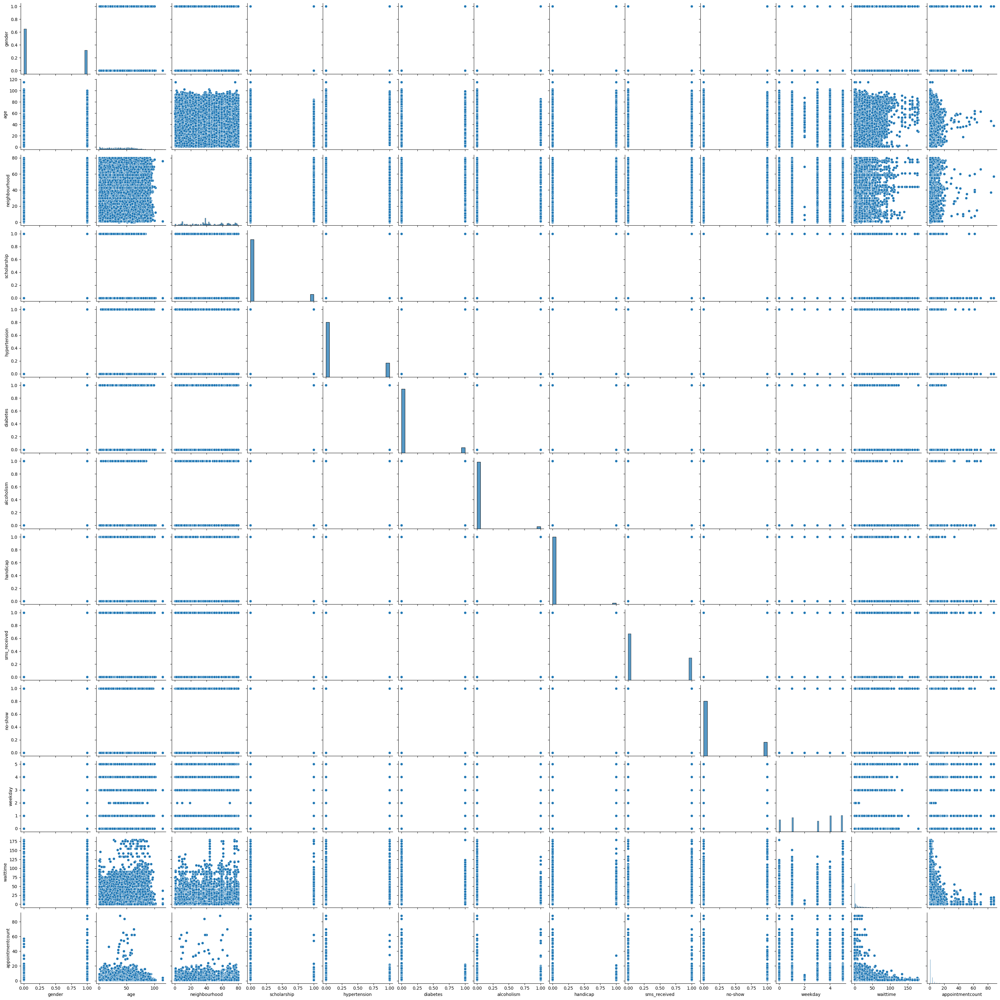

In [228]:
sns.pairplot(corr_df)
plt.show()

### Correlation Analysis Results
Pearson Correlation Coefficient for Continuous Variables:
1. Age vs. No-Show: Correlation is -0.067 indicating a weak negative correlation. Younger patients are slightly more likely to miss appointments.
2. Wait Time vs. No-Show: Correlation is 0.186 showing a weak positive correlation. Longer wait times might lead to higher no-show rates.
3. Appointment Count vs. No-Show: Correlation is −0.032, very weak negative correlation suggesting that patients with more appointments are slightly less likely to miss appointments.

Phi Coefficient for Binary Variables:
1. Scholarship vs. No-Show: Correlation is 0.029, very weak positive correlation.
2. Hypertension vs. No-Show: Correlation is −0.037, weak negative correlation indicating that patients with hypertension might be less likely to miss appointments.
3. Diabetes vs. No-Show: Correlation is −0.016, very weak negative correlation.
4. Alcoholism vs. No-Show: Almost no correlation (−0.0005).
5. Handicap vs. No-Show: Very weak negative correlation −0.008.
6. SMS Received vs. No-Show: Correlation is 0.127, closer to 0 indicating a ​linear  relationship between the two variables. This means that as the number of sms reminders increases, the likelihood of a patient missing an appointment also increases.

In [ ]:
# Setting up the visualization environment
plt.figure(figsize=(13, 4))

# Plot 1: Age Distribution by No-Show Status
plt.subplot(1, 2, 1)
sns.histplot(data=train_data, x='age', hue='no-show', multiple='stack', palette='pastel')
plt.title('Age Distribution by No-Show Status')
plt.xlabel('Age')
plt.ylabel('Count')

# Plot 2: Impact of SMS Received
plt.subplot(1, 2, 2)
sns.countplot(x='sms_received', hue='no-show', data=train_data, palette='pastel')
plt.title('Impact of SMS Received on No-Show Status')
plt.xlabel('SMS Received')
plt.ylabel('Count')

plt.tight_layout()
plt.show()

#### Further Observations:

From the results of the statistical tests and correlation tests on the feature variables, the following are observed;
* Some numerical feature variables like Age also show strong inverse relationship with the target variable
* In the expanded dataset, added feature variables like at_risk, weekday, appointmentcount and waittime also show relation to the target variable.

* The "sms_received" feature shows a strong positive correlation with "no-show", suggesting that patients who received an SMS are slightly more likely to miss their appointments. This is an interesting observation because one would expect that patients who receive SMS reminders are more likely to show up for their appointments but rather, the data shows that patients who receive SMS reminders are more likely to miss their appointments.<br>

* Features like "scholarship", "hypertension", "diabetes", "alcoholism", neighbourhood and "handicap" have very low correlations with "no-show", indicating that these conditions alone do not strongly predict whether a patient will miss an appointment. <br>

* The "age" feature shows a negative correlation with "no-show", meaning younger patients tend to miss appointments more than older ones.

From Observations in the analysis and correlation age, SMS reminders, appointment waittime and number of previous appointments are the factors that strongly influence no shows. This answers the research question 2 stated in Section (RQ:2 What factors strongly influence no-show?) as the feature variables that strongly influence no-show have been identified.

### SOLVING CLASS IMBALANCE:

The dataset's target variable has some class imbalance so In this section, I will solve the class imbalance problem by using the following sampling techniques:
* Upsampling the minority class (Oversampling)
* Downsampling the majority class (Undersampling)
* Synthetic Minority Over-sampling Technique (SMOTE) to balance the classes in the dataset.

These will help to improve the model's performance by reducing the bias in the model and improving the accuracy of the model's predictions.

In [215]:
# Upsampling the minority class
# Only the training data is upsampled to prevent a biased evaluation for the test data

# calculate the number of no-shows and shows in the training data
no_show_count = train_data['no-show'].value_counts().reset_index()

no_show_count.columns = ['no-show', 'count']

# calculate the percentage of no-shows and shows in the training data
no_show_percent = (train_data['no-show'].value_counts(normalize=True) * 100).round(1).reset_index()
no_show_percent.columns = ['no-show', 'percent']

no_show_dist = no_show_count.merge(no_show_percent, on='no-show')

print(no_show_dist)

   no-show  count  percent
0        0  68245     79.7
1        1  17340     20.3


#### Upsampling the Minority Class (Oversampling)
This involves increasing the number of instances in the minority class to balance the dataset. This will be done by randomly duplicating instances in the minority class to match the number of instances in the majority class.

In [216]:
# Seperate majority class and minority class in the training data
majority_class = train_data[train_data['no-show'] == 0]
minority_class = train_data[train_data['no-show'] == 1]

# upsample the minority class to balance the dataset
minority_upsampled = resample(minority_class,
                              replace=True, # sample with replacement
                              n_samples=len(majority_class), # match number in majority class
                              random_state=42) # reproducible results

# Combine the majority class and upsampled minority class
upsampled_data = pd.concat([majority_class, minority_upsampled]).reset_index(drop=True)

#### Downsampling the Majority Class (Undersampling)
This involves reducing the number of instances in the majority class to balance the dataset. This will be done by randomly removing instances in the majority class to match the number of instances in the minority class.

In [217]:
# downsample the majority class to balance the dataset
majority_downsampled = resample(majority_class,
                                replace=False, # sample without replacement
                                n_samples=len(minority_class), # match number in minority class
                                random_state=42) # reproducible results

# Combine the majority class and downsampled minority class
downsampled_data = pd.concat([majority_downsampled, minority_class]).reset_index(drop=True)

#### SMOTE: Synthetic Minority Over-sampling Technique (SMOTE)
This technique involves generating synthetic samples from the minority class to balance the dataset. This will be done by creating synthetic samples from the minority class by selecting two or more similar instances and creating a new instance between them. This will help to balance the dataset and improve the model's performance.

In [218]:
# Seperate features and target variable
X_train = train_data.drop('no-show', axis=1)
y_train = train_data['no-show']

# initialize the SMOTE object
smote = SMOTE(random_state=42)

# fit the SMOTE object on the training data
X_train_smote, y_train_smote = smote.fit_resample(X_train, y_train)

# Combine the resampled data and labels into a single dataframe
smote_data = pd.concat([pd.DataFrame(X_train_smote), pd.DataFrame(y_train_smote, columns=['no-show'])], axis=1)

In [219]:
# View the distribution of all sampled datasets to confirm operation success

# Check the distribution of the original training data
print(f"Original Training Data Distribution: {train_data['no-show'].value_counts()} \n")
print(f"Class Distribution in upsampled data: {upsampled_data['no-show'].value_counts()} \n")
print(f"Class Distribution in downsampled data: {downsampled_data['no-show'].value_counts()} \n")
print(f"Class Distribution in SMOTE data: {smote_data['no-show'].value_counts()} \n")

Original Training Data Distribution: no-show
0    68245
1    17340
Name: count, dtype: int64 

Class Distribution in upsampled data: no-show
0    68245
1    68245
Name: count, dtype: int64 

Class Distribution in downsampled data: no-show
0    17340
1    17340
Name: count, dtype: int64 

Class Distribution in SMOTE data: no-show
0    68245
1    68245
Name: count, dtype: int64 



### Scaling Features:
Scaling the feature variables is an important step in the data preprocessing process as it helps to standardize the feature variables and improve the model's performance.
This will be done using the StandardScaler to scale the feature variables to have a mean of 0 and a standard deviation of 1. and this would be done using the StandardScaler.

In [220]:
# Apply Standard Scaler to the numerical columns in the dataset
scaler = StandardScaler()

# show all feature columns for the dataset
feature_cols = train_data.columns.difference(['no-show'])

In [221]:
scaled_train = train_data.copy()
scaled_test = test_data.copy()

# Fit the scaler on the training data and transform the training and testing data
scaled_train[feature_cols] = scaler.fit_transform(train_data[feature_cols])
scaled_test[feature_cols] = scaler.transform(test_data[feature_cols])

In [222]:
# Create copies of resampled data
train_scaled_upsampled = upsampled_data.copy()
train_scaled_downsampled = downsampled_data.copy()
train_scaled_smote = smote_data.copy()


# Apply scaling to the features in the resampled data
train_scaled_upsampled[feature_cols] = scaler.fit_transform(upsampled_data[feature_cols])
train_scaled_downsampled[feature_cols] = scaler.fit_transform(downsampled_data[feature_cols])
train_scaled_smote[feature_cols] = scaler.fit_transform(smote_data[feature_cols])

Check the effectiveness of the Standard Scaler

In [223]:
# Define a function to check the scaling standar deviation

def check_scaling(data, cols):
    return all(np.logical_and(np.isclose(data[col].mean(), 0, atol=2e-1), np.isclose(data[col].std(), 1, atol=2e-1)) for col in cols)

# perform a check on all the datasets
print("Check on original scaled train data: ", check_scaling(scaled_train, feature_cols))
print("Check on original scaled test data: ", check_scaling(scaled_test, feature_cols))
print("Check on upsampled scaled train data: ", check_scaling(train_scaled_upsampled, feature_cols))
print("Check on downsampled scaled train data: ", check_scaling(train_scaled_downsampled, feature_cols))
print("Check on SMOTE scaled train data: ", check_scaling(train_scaled_smote, feature_cols))

Check on original scaled train data:  True
Check on original scaled test data:  True
Check on upsampled scaled train data:  True
Check on downsampled scaled train data:  True
Check on SMOTE scaled train data:  True


### Compute Feature Importance for Feature Selection
Next, I will compute the feature importance using the following models:

* Logistic Regression Coefficient
* Random Forest
* Decision Trees
* XGBoost

##### MEAN FEATURE IMPORTANCE ACROSS ALL THE MODELS

#### Logistic Regression Coefficient

         Feature  Coefficient  Absolute_Coefficient
1            age    -0.197156              0.197156
3    scholarship     0.061995              0.061995
8   sms_received     0.171822              0.171822
10      waittime     0.344072              0.344072


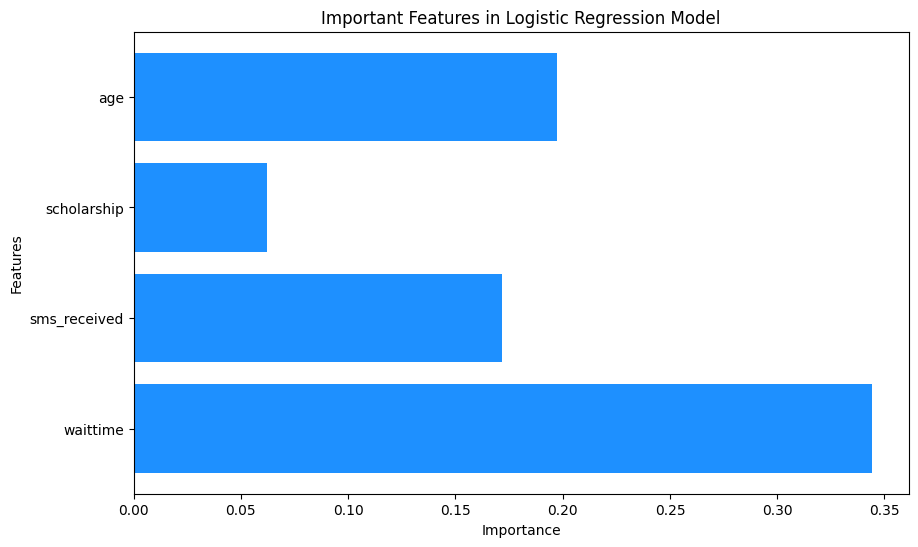

In [183]:
X = scaled_train.drop('no-show', axis=1)
y = scaled_train['no-show']

# Initialize and fit the Logistic Regression model
log_reg = LogisticRegression()
log_reg.fit(X, y)

# Get coefficients and create a DataFrame
coefficients = log_reg.coef_[0]
coefficients_df = pd.DataFrame({'Feature': X.columns, 'Coefficient': coefficients})
coefficients_df['Absolute_Coefficient'] = coefficients_df['Coefficient'].abs()

# Determine a threshold for importance
# The threshold for important features has been set to 5% importance
lr_important_features = coefficients_df[coefficients_df['Absolute_Coefficient'] > 0.05]
print(lr_important_features)

#store all important features in a list
important_features_lr = lr_important_features['Feature'].tolist()

# Plotting
plt.figure(figsize=(10, 6))
plt.barh(lr_important_features['Feature'], lr_important_features['Absolute_Coefficient'], color='dodgerblue')
plt.xlabel('Importance')
plt.ylabel('Features')
plt.title('Important Features in Logistic Regression Model')
plt.gca().invert_yaxis()  # Invert y-axis to have the highest values at the top
plt.show()


#### Random Forest Feature Importance

1                  age
10            waittime
2        neighbourhood
11    appointmentcount
9              weekday
Name: Feature, dtype: object


C:\Users\ktamu\AppData\Local\Temp\ipykernel_22792\413281025.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Importance', y='Feature', data=important_features_df, palette='viridis')


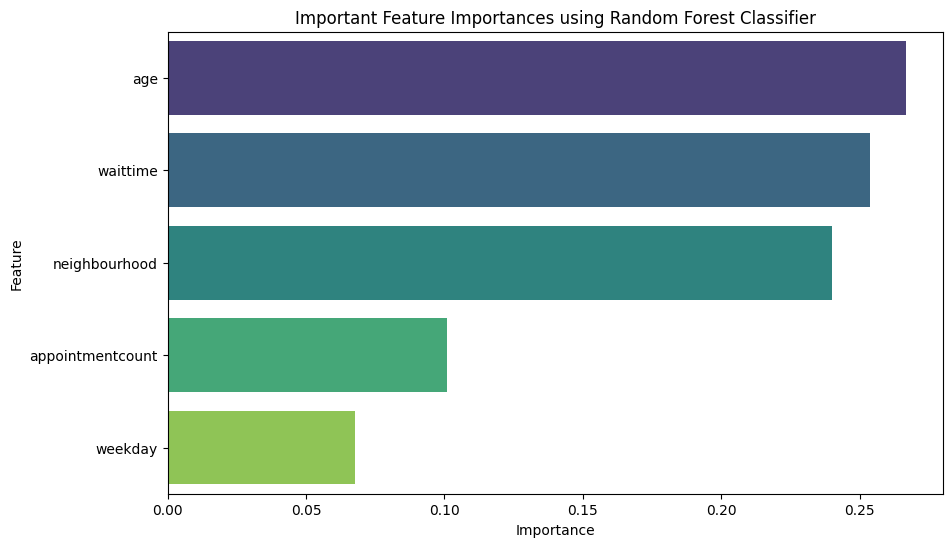

In [170]:
# Feature Importance using Random Forest Classifier
# Define the features and target variable
X = scaled_train.drop('no-show', axis=1)
y = scaled_train['no-show']

feature_names = X.columns
# Initialize the Random Forest Classifier
rf_clf = RandomForestClassifier()

# Fit the model
rf_clf.fit(X, y)

# Get the feature importances
rf_feature_importances = rf_clf.feature_importances_

# Create a dataframe of feature names and their importances
feature_importances_df = pd.DataFrame({'Feature': feature_names, 'Importance': rf_feature_importances})

# Sort the dataframe by importance and filter for important features
feature_importances_df = feature_importances_df.sort_values(by='Importance', ascending=False)
# The threshold for important features has been set to 5% importance
important_features_df = feature_importances_df[feature_importances_df['Importance'] > 0.05]

# store important features in a list
important_features_rf = important_features_df['Feature']
print(important_features_rf)

# Plot the important features
plt.figure(figsize=(10, 6))
sns.barplot(x='Importance', y='Feature', data=important_features_df, palette='viridis')
plt.title('Important Feature Importances using Random Forest Classifier')
plt.show()

#### Decision Tree Feature Importance

10            waittime
1                  age
2        neighbourhood
11    appointmentcount
9              weekday
Name: Feature, dtype: object


C:\Users\ktamu\AppData\Local\Temp\ipykernel_22792\1275558275.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Importance', y='Feature', data=important_features_df, palette='viridis')


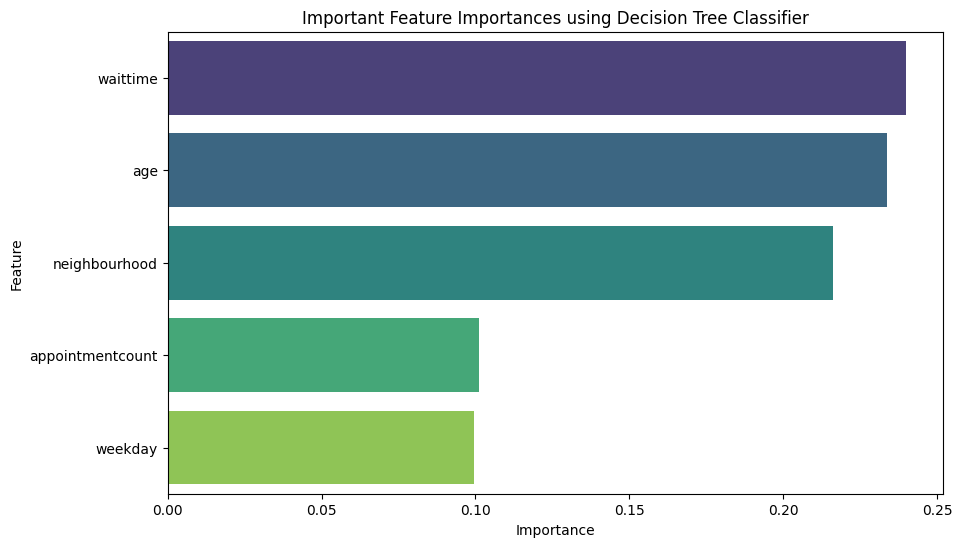

In [171]:
# Define the features and target variable
X = scaled_train.drop('no-show', axis=1)
y = scaled_train['no-show']

feature_names = X.columns

# Initialize the Decision Tree Classifier
dt_clf = DecisionTreeClassifier()

# Fit the model
dt_clf.fit(X, y)

# Get the feature importances
dt_feature_importances = dt_clf.feature_importances_

# Create a dataframe of feature names and their importances
feature_importances_df = pd.DataFrame({'Feature': feature_names, 'Importance': dt_feature_importances})

# Sort the dataframe by importance and filter for important features
feature_importances_df = feature_importances_df.sort_values(by='Importance', ascending=False)
# The threshold for important features has been set to 5% importance
important_features_df = feature_importances_df[feature_importances_df['Importance'] > 0.05]

# Store important features in a list
important_features_dt = important_features_df['Feature']
print(important_features_dt)

# Plot the important features
plt.figure(figsize=(10, 6))
sns.barplot(x='Importance', y='Feature', data=important_features_df, palette='viridis')
plt.title('Important Feature Importances using Decision Tree Classifier')
plt.show()

#### XGBoost Feature Importance

10            waittime
1                  age
11    appointmentcount
6           alcoholism
8         sms_received
12             at_risk
3          scholarship
0               gender
2        neighbourhood
Name: Feature, dtype: object


C:\Users\ktamu\AppData\Local\Temp\ipykernel_22792\2851215044.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Importance', y='Feature', data=important_features_df, palette='viridis')


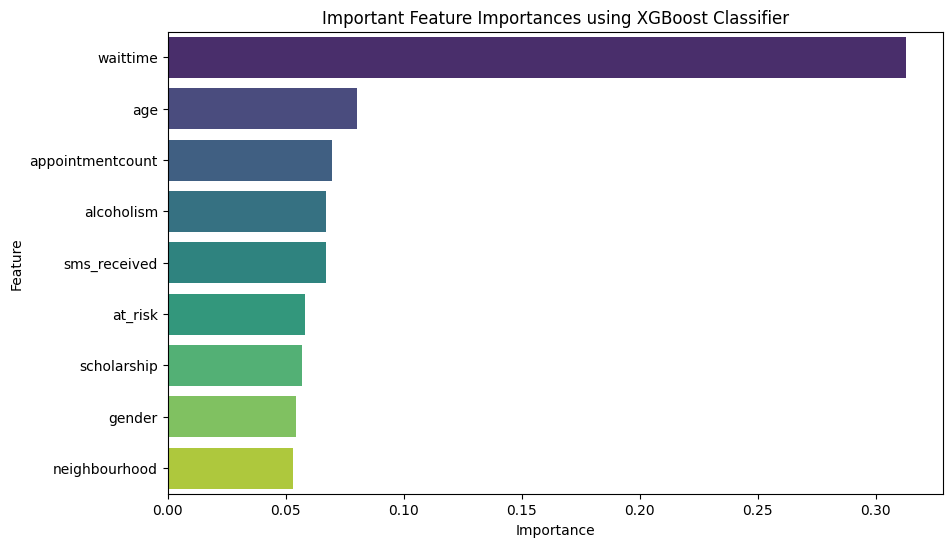

In [172]:
# Define the features and target variable
X = scaled_train.drop('no-show', axis=1)
y = scaled_train['no-show']

feature_names = X.columns

# Initialize the XGBoost Classifier
xgb_clf = xgb.XGBClassifier(use_label_encoder=False, eval_metric='logloss')

# Fit the model
xgb_clf.fit(X, y)

# Get the feature importances
xgb_feature_importances = xgb_clf.feature_importances_

# Create a dataframe of feature names and their importances
feature_importances_df = pd.DataFrame({'Feature': feature_names, 'Importance': xgb_feature_importances})

# Sort the dataframe by importance and filter for important features
feature_importances_df = feature_importances_df.sort_values(by='Importance', ascending=False)
# The threshold for important features has been set to 5% importance
important_features_df = feature_importances_df[feature_importances_df['Importance'] > 0.05]

# Store important features in a list
important_features_xgb = important_features_df['Feature']
print(important_features_xgb)

# Plot the important features
plt.figure(figsize=(10, 6))
sns.barplot(x='Importance', y='Feature', data=important_features_df, palette='viridis')
plt.title('Important Feature Importances using XGBoost Classifier')
plt.show()


In [ ]:
# from sklearn.tree import plot_tree

# def plot_model_insights(model, X, model_type, threshold=0.05):
#     plt.figure(figsize=(10, 6))

#     if model_type == 'logistic_regression':
#         # Logistic regression coefficients plotting
#         coeffs = model.coef_[0]
#         important_indices = np.where(np.abs(coeffs) >= threshold)[0]
#         important_features = X.columns[important_indices]
#         important_coeffs = coeffs[important_indices]
#         plt.barh(important_features, important_coeffs, align='center')
#         plt.title('Logistic Regression Coefficients with Threshold')

#     elif model_type == 'decision_tree':
#         # Decision Tree feature importances plotting
#         importances = model.feature_importances_
#         indices = np.argsort(importances)[::-1]
#         important_indices = [idx for idx in indices if importances[idx] >= threshold]
#         plt.bar(range(len(important_indices)), importances[important_indices], align='center')
#         plt.xticks(range(len(important_indices)), X.columns[important_indices], rotation=90)
#         plt.title('Decision Tree Feature Importances with Threshold')

#     elif model_type in ['random_forest', 'xgboost']:
#         # Random Forest and XGBoost feature importances plotting
#         importances = model.feature_importances_
#         indices = np.argsort(importances)[::-1]
#         important_indices = [idx for idx in indices if importances[idx] >= threshold]
#         plt.bar(range(len(important_indices)), importances[important_indices], align='center')
#         plt.xticks(range(len(important_indices)), X.columns[important_indices], rotation=90)
#         plt.title(f'{model_type.title()} Feature Importances with Threshold')

#     plt.tight_layout()
#     plt.show()

# models = [log_reg, dt_clf, rf_clf, xgb_clf]
# model_type = ['logistic_regression', 'decision_tree', 'random_forest', 'xgboost']

# # Plot insights for each model
# for model, m_type in zip(models, model_type):
#     plot_model_insights(model, X, m_type)

#### Combine Important Features from Linear Regression, Random Forest, Decision Tree, and XGBoost

In [174]:
# Convert the important features from all models to a list
combined_features = list(set(important_features_lr) | set(important_features_rf) | set(important_features_dt) | set(important_features_xgb))

# Display the combined important features
print("Combined Important Features from all Models: \n", combined_features)
print("Number of Combined Important Features: ", len(combined_features))

Combined Important Features from all Models: 
 ['appointmentcount', 'scholarship', 'at_risk', 'weekday', 'sms_received', 'waittime', 'neighbourhood', 'age', 'alcoholism', 'gender']
Number of Combined Important Features:  10


In [175]:
# Add the target variable to the combined list of important features
combined_features.append('no-show')

print("Number of Combined Important Features with Target Variable: ", len(combined_features))

Number of Combined Important Features with Target Variable:  11


#### Filter all the datasets created (Both original, Scaled and Sampled) train and test sets

In [176]:
# Filter Original train and test datasets to include only important features
filtered_train_data = train_data[combined_features]
filtered_test_data = test_data[combined_features]

#Filter the scaled train and test datasets to include only important features
filtered_scaled_train_data = scaled_train[combined_features]
filtered_scaled_test_data = scaled_test[combined_features]

# Filter the unscaled upsampled, downsampled and SMOTE train datasets to include only important features
filtered_upsampled_train_data = upsampled_data[combined_features]
filtered_downsampled_train_data = downsampled_data[combined_features]
filtered_smote_train_data = smote_data[combined_features]

# Filter the scaled upsampled, downsampled and SMOTE train datasets to include only important features
filtered_upsampled_scaled_train_data = train_scaled_upsampled[combined_features]
filtered_downsampled_scaled_train_data = train_scaled_downsampled[combined_features]
filtered_smote_scaled_train_data = train_scaled_smote[combined_features]

#### Preparing Datsets

In [177]:
# Prepare Dataset for training and testing the models

# Original train and test datasets
X_train = filtered_train_data.drop('no-show', axis=1)
y_train = filtered_train_data['no-show']

X_test = filtered_test_data.drop('no-show', axis=1)
y_test = filtered_test_data['no-show']

# Scaled train and test datasets
X_train_scaled = filtered_scaled_train_data.drop('no-show', axis=1)
y_train_scaled = filtered_scaled_train_data['no-show']

# Upsampled train dataset
X_train_upsampled = filtered_upsampled_train_data.drop('no-show', axis=1)
y_train_upsampled = filtered_upsampled_train_data['no-show']

# Downsampled train dataset
X_train_downsampled = filtered_downsampled_train_data.drop('no-show', axis=1)
y_train_downsampled = filtered_downsampled_train_data['no-show']

# SMOTE train dataset
X_train_smote = filtered_smote_train_data.drop('no-show', axis=1)
y_train_smote = filtered_smote_train_data['no-show']

# Scaled upsampled train dataset
X_train_upsampled_scaled = filtered_upsampled_scaled_train_data.drop('no-show', axis=1)
# y_train_upsampled_scaled = filtered_upsampled_scaled_train_data['no-show']

# Scaled downsampled train dataset
X_train_downsampled_scaled = filtered_downsampled_scaled_train_data.drop('no-show', axis=1)
# y_train_downsampled_scaled = filtered_downsampled_scaled_train_data['no-show']

# Scaled SMOTE train dataset
X_train_smote_scaled = filtered_smote_scaled_train_data.drop('no-show', axis=1)
# y_train_smote_scaled = filtered_smote_scaled_train_data['no-show']


Logistic Regression Classification Report
              precision    recall  f1-score   support

           0       0.80      0.99      0.88     68245
           1       0.33      0.02      0.03     17340

    accuracy                           0.79     85585
   macro avg       0.56      0.50      0.46     85585
weighted avg       0.70      0.79      0.71     85585

Logistic Regression ROC AUC Score: 0.66

Decision Tree Classification Report
              precision    recall  f1-score   support

           0       0.99      1.00      0.99     68245
           1       1.00      0.95      0.97     17340

    accuracy                           0.99     85585
   macro avg       0.99      0.97      0.98     85585
weighted avg       0.99      0.99      0.99     85585

Decision Tree ROC AUC Score: 1.00

Random Forest Classification Report
              precision    recall  f1-score   support

           0       0.99      1.00      0.99     68245
           1       0.99      0.96      0.97   

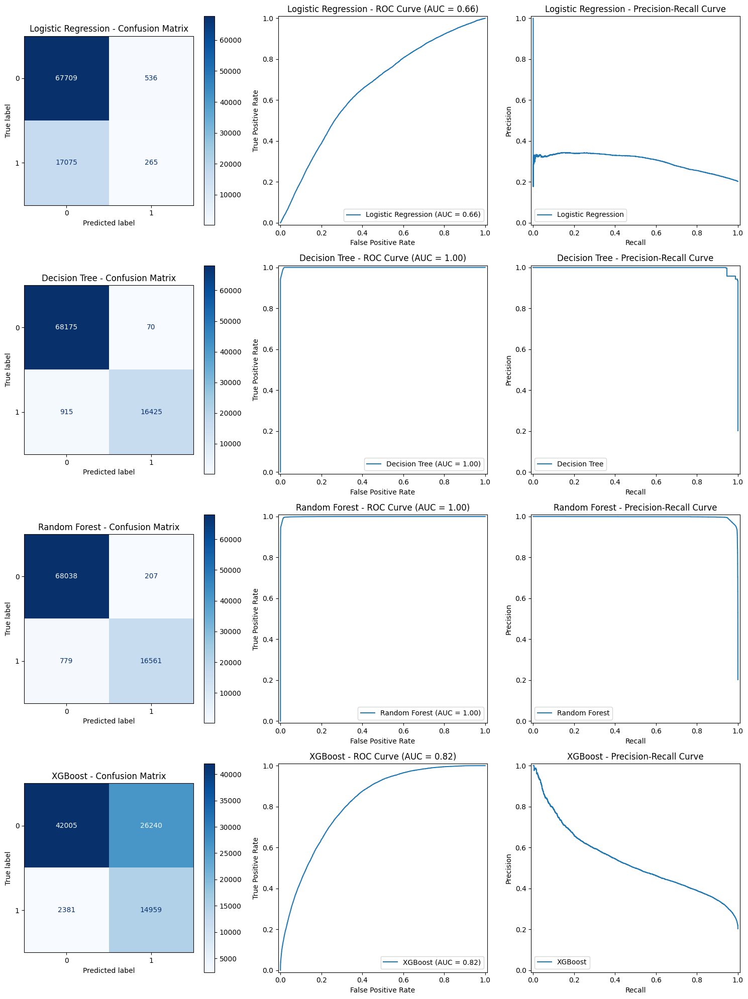

In [186]:
from sklearn.metrics import  RocCurveDisplay, PrecisionRecallDisplay

X_train = X_train_scaled
y_train = y_train_scaled

# Initialize models
logistic_regression_model = LogisticRegression(max_iter=1000)
decision_tree_model = DecisionTreeClassifier(random_state=42)
random_forest_model = RandomForestClassifier(random_state=42)
xgb_model = xgb.XGBClassifier(use_label_encoder=False, eval_metric='logloss', random_state=42, scale_pos_weight=(0.798 / 0.202))

# Fit models on the training data
logistic_regression_model.fit(X_train, y_train)
decision_tree_model.fit(X_train, y_train)
random_forest_model.fit(X_train, y_train)
xgb_model.fit(X_train, y_train)

# Models dictionary after fitting
models = {
    "Logistic Regression": logistic_regression_model,
    "Decision Tree": decision_tree_model,
    "Random Forest": random_forest_model,
    "XGBoost": xgb_model
}


# Define test dataset
# X_test = X_test
# y_test = y_test


# Initialize subplots grid: 4 rows (one per model) by 3 columns (CM, ROC, PR curves)
fig, axes = plt.subplots(len(models), 3, figsize=(15, 20))

# Loop through each model to evaluate and generate graphs
for idx, (name, model) in enumerate(models.items()):
    y_pred = model.predict(X_test)
    y_pred_proba = model.predict_proba(X_test)[:, 1]

    # Display classification report
    print(f"\n{name} Classification Report")
    print(classification_report(y_test, y_pred))

    # Calculate and display ROC AUC score
    roc_auc = roc_auc_score(y_test, y_pred_proba)
    print(f"{name} ROC AUC Score: {roc_auc:.2f}")

    # Confusion Matrix
    cm = confusion_matrix(y_test, y_pred)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm)
    disp.plot(ax=axes[idx, 0], cmap=plt.cm.Blues)
    axes[idx, 0].set_title(f"{name} - Confusion Matrix")

    # ROC Curve
    fpr, tpr, _ = roc_curve(y_test, y_pred_proba)
    RocCurveDisplay(fpr=fpr, tpr=tpr, roc_auc=roc_auc, estimator_name=name).plot(ax=axes[idx, 1])
    axes[idx, 1].set_title(f"{name} - ROC Curve (AUC = {roc_auc:.2f})")

    # Precision-Recall Curve
    precision, recall, _ = precision_recall_curve(y_test, y_pred_proba)
    PrecisionRecallDisplay(precision=precision, recall=recall, estimator_name=name).plot(ax=axes[idx, 2])
    axes[idx, 2].set_title(f"{name} - Precision-Recall Curve")

# Adjust the layout for neat plotting
plt.tight_layout()
plt.show()


#### Model Selection

Multiple machine learning models (Logistic Regression, Random Forest, Decision Tree, XGBoost, and Deep Learning Models) will be used to predict the probability in outcome of the target variable (no-show) with k-fold cross validation to identify the best performing model based on the metrics (accuracy, precision, recall, f1-score, and ROC-AUC score).

In [227]:
stratified_kfold = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

# Initialize the models
log_reg = LogisticRegression(class_weight='balanced', random_state=42)
rf_model = RandomForestClassifier(class_weight='balanced', random_state=42)
dt_model = DecisionTreeClassifier(class_weight='balanced', random_state=42)
xgb_model = xgb.XGBClassifier(use_label_encoder=False, eval_metric='logloss', random_state=42, scale_pos_weight=(0.798 / 0.202))

# Create a dictionary of models
models = {
    'Logistic Regression': log_reg,
    'Random Forest': rf_model,
    'Decision Tree': dt_model,
    'XGBoost': xgb_model
}

# Perform cross-validation using ROC AUC as the scoring metric
for name, model in models.items():
    # Ensure the model supports probability prediction for ROC AUC score calculation
    if hasattr(model, "predict_proba"):
        cv_scores = cross_val_score(model, X_train, y_train, cv=stratified_kfold, scoring='roc_auc')  # Changed scoring to roc_auc
        # print(f'{name}: Mean ROC AUC = {np.mean(cv_scores):.2f}, Std ROC AUC = {np.std(cv_scores):.2f}')
        print(f'{name}: ROC AUC = {np.mean(cv_scores):.2f}')
    else:
        print(f"{name} does not support probability estimates and cannot compute ROC AUC.")


c:\Users\ktamu\OneDrive\Desktop\Coursework\Masters_Dissertation\venv\lib\site-packages\sklearn\linear_model\_logistic.py:469: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
c:\Users\ktamu\OneDrive\Desktop\Coursework\Masters_Dissertation\venv\lib\site-packages\sklearn\linear_model\_logistic.py:469: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
   

Logistic Regression: ROC AUC = 0.67
Random Forest: ROC AUC = 0.72
Decision Tree: ROC AUC = 0.58
XGBoost: ROC AUC = 0.74


Based on the results of the cross-validation, XGBoost is the best performing model with the highest ROC AUC. All the models were trained on the original dataset.

In [ ]:
# from sklearn.tree import export_graphviz
# import graphviz

# dt_model.fit(X_train_scaled, y_train)

# # Visualize the decision tree
# dot_data = export_graphviz(dt_model, out_file=None, 
#                            feature_names=X_train.columns,  
#                            class_names=['Class0', 'Class1'],
#                            filled=True, rounded=True, 
#                            special_characters=True)  
# graph = graphviz.Source(dot_data)  
# graph.render("Decision Tree")  # Saves the tree visualization to a file


#### Dataset Selection

The best model (XGBoost) will be fit on the original dataset and the resampled datasets (upsampled, downsampled, and SMOTE) to determine the best dataset that improves the model's performance. This will help identify the best sampled dataset for the model.

In [389]:
xgb_original_model = xgb.XGBClassifier(random_state=42, scale_pos_weight=(0.798 / 0.202))

# initialize the best performing model for the resampled datasets
# the scale_pos_weight parameter is removed as the dataset has been resampled and isn't the same as the original dataset split 79.8:20.2
xgb_resampled_model = xgb.XGBClassifier(random_state=42)

# all_datasets
datasets = {
    "Original": (X_train, y_train),
    "Upsampled": (X_train_upsampled, y_train_upsampled),
    "Downsampled": (X_train_downsampled, y_train_downsampled),
    "SMOTE": (X_train_smote, y_train_smote),
}

# store the results of the models in a dictionary
results = {}

# loop through all the datasets and train the XGBoost
for dataset, (X, y) in datasets.items():
    if dataset == "Original":
        model = xgb_original_model
    else:
        model = xgb_resampled_model

    # fit the XGboost model
    model.fit(X, y)

    # predict the target variable
    y_pred = model.predict(X_test)
    y_pred_proba = model.predict_proba(X_test)[:, 1]

    # Evaluate the model using the predicited probabilities
    roc_auc = roc_auc_score(y_test, y_pred_proba)
    accuracy = accuracy_score(y_test, y_pred)
    f1 = f1_score(y_test, y_pred)

    # store the results in the dictionary
    results[dataset] = {"ROC AUC": roc_auc, "Accuracy": accuracy, "F1": f1}

# print the results
for dataset, metrics in results.items():
    print(f"\nResults for {dataset}:")
    for metric, value in metrics.items():
        print(f"{metric}: {value:.2f}")


Results for Original:
ROC AUC: 0.75
Accuracy: 0.63
F1: 0.46

Results for Upsampled:
ROC AUC: 0.74
Accuracy: 0.63
F1: 0.45

Results for Downsampled:
ROC AUC: 0.74
Accuracy: 0.62
F1: 0.46

Results for SMOTE:
ROC AUC: 0.71
Accuracy: 0.68
F1: 0.42


Based on the results above, the XGboost model trained on the original dataset and test set perform better based on the ROC AUC metric, f1 score and accuracy compared to the XGBoost models trained on the resampled datasets.

#### HYPERPARAMETER TUNING
Hyperparameter tuning will be performed to improve the performance of the selected model. The main objective is to maximize the ROC AUC score. 

In [398]:
best_score = 0
iteration = 0

# Define parameter Space
space = {
    'max_depth': hp.choice('max_depth', range(3, 14)),
    'learning_rate': hp.uniform('learning_rate', 0.01, 0.2),
    'n_estimators': hp.choice('n_estimators', range(100, 1000, 1)),
    'gamma': hp.uniform('gamma', 0, 0.5),
    'subsample': hp.uniform('subsample', 0.6, 1.0),
    'colsample_bytree': hp.uniform('colsample_bytree', 0.3, 1.0),
    'min_child_weight': hp.choice('min_child_weight', range(1, 10)),
}

def objective(params):
    # define the best score and iteration variables as global so they can be updaed 
    global best_score
    global iteration
    iteration += 1
    
    clf = xgb.XGBClassifier(
        n_estimators=int(params['n_estimators']),
        max_depth=int(params['max_depth']),
        learning_rate=params['learning_rate'],
        gamma=params['gamma'],
        colsample_bytree=params['colsample_bytree'],
        subsample=params['subsample'],
        min_child_weight=int(params['min_child_weight']),
        scale_pos_weight = (0.798 / 0.202),
        random_state=42
    )
    # stratified cross-validation
    skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
    score = cross_val_score(clf, X_train_scaled, y_train, cv=skf, scoring='roc_auc').mean()
    
    if score > best_score:
        best_score = score
        print(f"iteration: {iteration}, ROC AUC: {best_score}")
        display("Best Parameters so far: ", params)
        
    return {'loss': -score, 'status': STATUS_OK}



# intialize the trial object
trials = Trials()

# Run the hyperparameter optimization
best = fmin(
    fn=objective, 
    space=space, 
    algo=tpe.suggest, 
    max_evals=100, 
    trials=trials
    )


iteration: 1, ROC AUC: 0.7273937095492587              
  0%|          | 0/100 [00:12<?, ?trial/s, best loss=?]

'Best Parameters so far: '

{'colsample_bytree': 0.3724285359498682,
 'gamma': 0.4134690204178987,
 'learning_rate': 0.13764865644447502,
 'max_depth': 10,
 'min_child_weight': 4,
 'n_estimators': 938,
 'subsample': 0.7259318142646375}

iteration: 2, ROC AUC: 0.7421054924320687                                         
  1%|          | 1/100 [00:15<20:37, 12.50s/trial, best loss: -0.7273937095492587]

'Best Parameters so far: '

{'colsample_bytree': 0.5541032233207943,
 'gamma': 0.28246990451427206,
 'learning_rate': 0.12288825298685123,
 'max_depth': 11,
 'min_child_weight': 5,
 'n_estimators': 121,
 'subsample': 0.8239802122841647}

iteration: 3, ROC AUC: 0.7444246943238213                                         
  2%|▏         | 2/100 [00:19<10:55,  6.69s/trial, best loss: -0.7421054924320687]

'Best Parameters so far: '

{'colsample_bytree': 0.3309051511651658,
 'gamma': 0.03628938167237117,
 'learning_rate': 0.059826491104091876,
 'max_depth': 7,
 'min_child_weight': 3,
 'n_estimators': 428,
 'subsample': 0.8704413929861803}

iteration: 8, ROC AUC: 0.7472337014604836                                         
  7%|▋         | 7/100 [01:09<12:06,  7.82s/trial, best loss: -0.7444246943238213]

'Best Parameters so far: '

{'colsample_bytree': 0.7257338770045637,
 'gamma': 0.2882150729598475,
 'learning_rate': 0.030067672420696287,
 'max_depth': 7,
 'min_child_weight': 8,
 'n_estimators': 749,
 'subsample': 0.8196157036633913}

iteration: 19, ROC AUC: 0.7474228986867402                                         
 18%|█▊        | 18/100 [02:21<06:54,  5.05s/trial, best loss: -0.7472337014604836]

'Best Parameters so far: '

{'colsample_bytree': 0.6997275604832758,
 'gamma': 0.3586797796345118,
 'learning_rate': 0.04508585268965362,
 'max_depth': 8,
 'min_child_weight': 8,
 'n_estimators': 459,
 'subsample': 0.935956625190636}

iteration: 58, ROC AUC: 0.7476831600102859                                         
 57%|█████▋    | 57/100 [07:25<06:33,  9.16s/trial, best loss: -0.7474228986867402]

'Best Parameters so far: '

{'colsample_bytree': 0.7265643284457186,
 'gamma': 0.4103859157079925,
 'learning_rate': 0.03774033214353302,
 'max_depth': 8,
 'min_child_weight': 8,
 'n_estimators': 811,
 'subsample': 0.9953291328236634}

iteration: 59, ROC AUC: 0.7479662481241048                                         
 58%|█████▊    | 58/100 [07:31<06:00,  8.59s/trial, best loss: -0.7476831600102859]

'Best Parameters so far: '

{'colsample_bytree': 0.7141797094908549,
 'gamma': 0.41285151569016043,
 'learning_rate': 0.04060921477029544,
 'max_depth': 8,
 'min_child_weight': 6,
 'n_estimators': 558,
 'subsample': 0.9952763642453927}

iteration: 71, ROC AUC: 0.7488076028401301                                         
 70%|███████   | 70/100 [09:02<05:17, 10.58s/trial, best loss: -0.7479662481241048]

'Best Parameters so far: '

{'colsample_bytree': 0.5692444447194046,
 'gamma': 0.3980764090412206,
 'learning_rate': 0.02458468018096031,
 'max_depth': 8,
 'min_child_weight': 1,
 'n_estimators': 493,
 'subsample': 0.9460536533505792}

100%|██████████| 100/100 [12:32<00:00,  7.53s/trial, best loss: -0.7488076028401301]


The results of the hyperparameter tuning show that the best hyperparameters for the XGBoost model are:
{'colsample_bytree': 0.5692444447194046,
 'gamma': 0.3980764090412206,
 'learning_rate': 0.02458468018096031,
 'max_depth': 8,
 'min_child_weight': 1,
 'n_estimators': 493,
 'subsample': 0.9460536533505792}

This was gotten at the 71st iteration and an ROC AUC score of 0.7488076028401301 (approximately 0.75) same as best loss. This is approximately 0.01 higher than the ROC AUC score of the model without hyperparameter tuning which is almost the same as before so there was just a slight improvement in model performance after hyper-parameter tuning. The best hyperparameters will saved and used to train the model and make predictions on the test set.

#### Train Final Gradient Boost Model

The best model chosen was the Gradient Boosting classifier (XGBoost) trained on the original data **( reduced by 2 features). The model's performance is evaluated on the test data to give the results below;

In [406]:
best_params = {
    'colsample_bytree': 0.5692444447194046,
    'gamma': 0.3980764090412206,
    'learning_rate': 0.02458468018096031,
    'max_depth': int(8),
    'min_child_weight': int(1),
    'n_estimators': int(493),
    'subsample': 0.9460536533505792,
    'scale_pos_weight': 0.798 / 0.202, 
    'random_state':42
 }

# save the best parameters in a pickle file
with open('data/XGBoost_best_hyperparameters.pkl', 'wb') as f:
    pickle.dump(best_params, f)

# initialize the model
xgb_model_final = xgb.XGBClassifier(**best_params)
xgb_model_final.fit(X_train, y_train)

# Predict the target variable
y_pred_final = xgb_model_final.predict(X_test)
y_pred_proba_final = xgb_model_final.predict_proba(X_test)[:, 1]

# Evaluate the model
roc_auc_final = roc_auc_score(y_test, y_pred_proba_final)
f1_score_final = f1_score(y_test, y_pred_final)

print(f"ROC AUC: {roc_auc_final:.2f}")
print(f"F1 Score: {f1_score_final:.2f}")

ROC AUC: 0.75
F1 Score: 0.46


In [407]:
# save the final predictive model in a pickle file
with open('data/xgb_model_final.pkl', 'wb') as file:
    pickle.dump(xgb_model_final, file)
print("Predictive model saved successfully")

Predictive model saved successfully


#### Model Evaluation
In this section, the final selected predictive model used for predicting patient no-show probability at medical appointments will be evaluated. This evaluation will include key metrics and visualizations to test the accuracy and reliability of the model. 

* Precision-Recall Curve: This curve shows the tradeoff between precision and recall for different threshold values. A high area under the curve represents both high recall and high precision, where high precision relates to a low false positive rate, and high recall relates to a low false negative rate. This metric is suitable for this use case because the classes are imbalanced. <br>

* Confusion Matrix: A confusion matrix is a table used to describe the performance of a classification model on a set of test data for which the true values are known. It shows the number of correct and incorrect predictions made by the model compared to the actual classifications in the data. The matrix itself is divided into four parts: true positives (TP), false positives (FP), true negatives (TN), and false negatives (FN), which help in further analysis of the model’s performance. <br>

* ROC Curve: The Receiver Operating Characteristic curve is a graphical plot that illustrates the diagnostic ability of a binary classifier system to distinguish between two classes as its discrimination threshold is varied. It plots the true positive rate (TPR) against the false positive rate (FPR) at various threshold settings. The area under the curve (AUC) represents the model's ability to correctly classify the positives and negatives (no-show or show). <br>

* Classification Report: This is a performance evaluation metric that displays the precision, recall and F1-score for each class. The report helps in assessing the effectiveness of the classification model, particularly:
    * Precision: Measures the accuracy of positive predictions.
    * Recall: Measures the ability of the model to find all the relevant cases (all actual positives).
    * F1-Score: Provides a balance between precision and recall, useful when the classes are unevenly distributed.



In [408]:
# load selected model from pickle file
with open('data/xgb_model_final.pkl', 'rb') as file:
    xgb_model = pickle.load(file)

In [409]:
# Make predictions on the test set using model
y_pred_eval = xgb_model.predict(X_test)
y_pred_proba_eval = xgb_model.predict_proba(X_test)[:, 1]

In [414]:
# Generate the Classification Report
classification_report_eval = classification_report(y_test, y_pred_eval, target_names=['No-Show', 'Show'])

print("Classification Report: \n", classification_report_eval)

Classification Report: 
               precision    recall  f1-score   support

     No-Show       0.92      0.58      0.71     17062
        Show       0.32      0.79      0.46      4335

    accuracy                           0.62     21397
   macro avg       0.62      0.69      0.59     21397
weighted avg       0.80      0.62      0.66     21397



The classification report summarizes the model's performance in identifying patient appointment no-shows. It is highly precise in predicting no-shows (92% accuracy), but significantly less so for predicting shows (32%). It's more reliable in detecting shows (79% coverage) than no-shows (58%), missing many no-show cases. The model's F1-score, which combines precision and recall, is better for no-shows (0.71) than shows (0.46), indicating a better balance for no-show predictions. The model's overall accuracy is 62%, reflecting correct predictions for patient attendance over half the time. There were more no-shows than shows in the data used to evaluate the model.

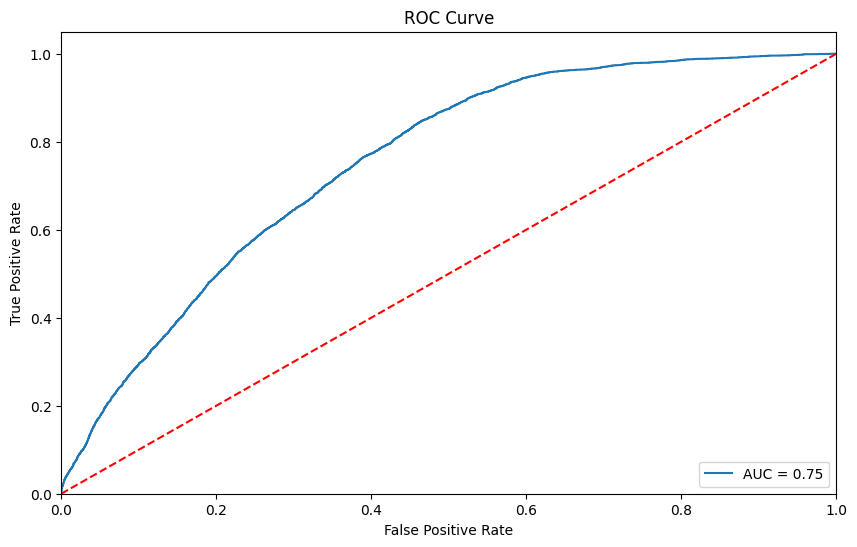

In [416]:
# Calculate the ROC curve
fpr, tpr, thresholds = roc_curve(y_test, y_pred_proba_eval)

# Calculate the AUC
roc_auc = auc(fpr, tpr)

# Plot the ROC curve
plt.figure(figsize=(10, 6))
plt.plot(fpr, tpr, label=f'AUC = {roc_auc:.2f}')
plt.plot([0, 1], [0, 1], linestyle='--', color='red')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.title('ROC Curve')  
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.legend( loc='lower right')
plt.show()

The Area Under the Curve (AUC) value is 0.75, indicating the predictive model's capability of distinguishing between No-Shows and Shows is good but not perfect. An AUC of 1.0 would represent a perfect model (Model that identifies more positive instances correctly and not flag negative as postive), while an AUC of 0.0 would represent a completely incorrect model.

This predictive model has a 75% chance of correctly distinguishing between the positive class and negative class, which is moderate. The model's performance can be further improved by using more data, feature engineering, and hyperparameter tuning.

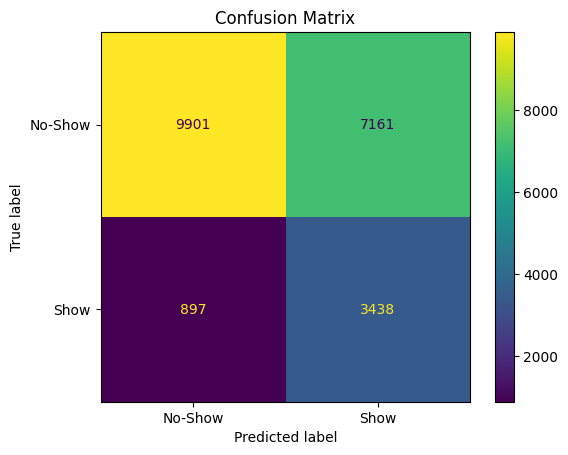

In [413]:
# Generate Confusion Matrix
cm = confusion_matrix(y_test, y_pred_eval)

# plot the confusion matrix
ConfusionMatrixDisplay(cm, display_labels=["No-Show", "Show"]).plot()
plt.title('Confusion Matrix')
plt.show()

* True Positives (TP): 9,901 instances were correctly predicted as no-shows.
* True Negatives (TN): 3,438 instances were correctly predicted as shows.
* False Positives (FP): 7,161 instances were incorrectly predicted as no-shows when they actually showed up.
* False Negatives (FN): 897 instances were incorrectly predicted as shows when they actually did not show up.

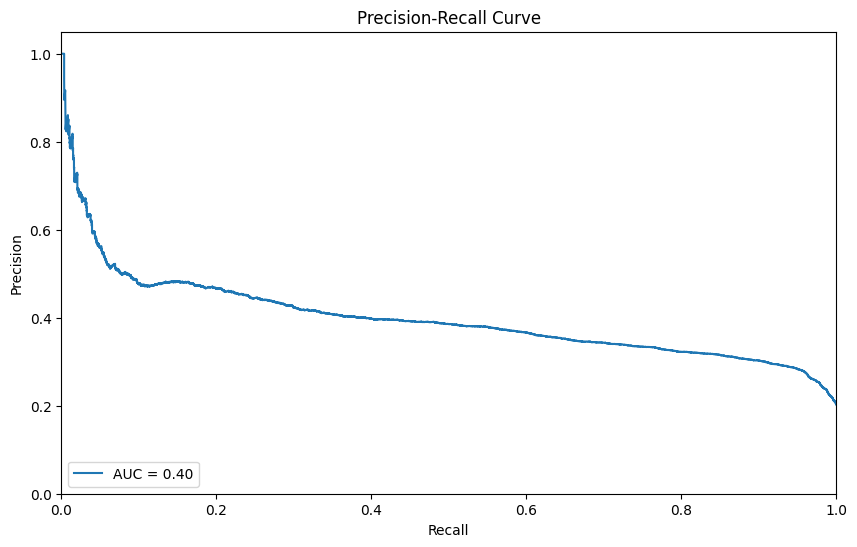

In [418]:
# calculate the precision recall 
precision, recall, thresholds = precision_recall_curve(y_test, y_pred_proba_eval)

# calculate the area under the precision recall curve
auc_pr = auc(recall, precision)

# plot the precision recall curve
plt.figure(figsize=(10, 6))
plt.plot(recall, precision, label=f'AUC = {auc_pr:.2f}')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.title('Precision-Recall Curve')
plt.xlabel('Recall')
plt.ylabel('Precision') 
plt.legend(loc="lower left")
plt.show()

The Area Under the Precision-Recall Curve (AUC) is 0.40, which is relatively low and indicates that the model is not very precise across all levels of recall and struggles to achieve a balance between precision and recall. Typically, a higher AUC for a PR curve indicates a better-performing model, with 1 being perfect and 0.5 being the performance of a random classifier. The model is moderately good at identifying most actual no-shows, but it also wrongly classifies patients who would have shown up as no-shows.